# Importer dataframe segmentation 

In [164]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set_style('darkgrid')
sns.set_color_codes(palette='dark')
import scipy
import scipy.stats as stats
from scipy.stats import norm
from scipy.stats import shapiro
from scipy.stats import normaltest
from DS_P5_TOOLBOX import *
from IPython.display import Markdown
from termcolor import colored
from tabulate import tabulate
from google.colab import data_table
from IPython.core.display import display, HTML
from IPython.display import display_html
display(HTML("<style>.container { width:100% !important; }</style>"))
from warnings import filterwarnings
filterwarnings('ignore')
import sklearn
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, QuantileTransformer,PowerTransformer
from sklearn import decomposition
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.metrics.cluster import adjusted_mutual_info_score
from sklearn.cluster import Birch


In [183]:
# print version pour requirements.txt
dict_packs = {'seaborn': sns, 'pandas': pd, 'numpy': np, 'scikit_posthocs': sp, 'sklearn': sklearn, 'scipy': scipy}

for keys, values in dict_packs.items():
  print(f'{keys}==',values.__version__)

seaborn== 0.11.2
pandas== 1.3.5
numpy== 1.19.5
scikit_posthocs== 0.6.7
sklearn== 1.0.2
scipy== 1.4.1


In [90]:
# Davies Bouldin score for K means
from sklearn.metrics import davies_bouldin_score
def get_kmeans_score(data, center):
    '''
    returns the kmeans score regarding Davies Bouldin for points to centers
    INPUT:
        data - the dataset you want to fit kmeans to
        center - the number of centers you want (the k value)
    OUTPUT:
        score - the Davies Bouldin score for the kmeans model fit to the data
    '''
    #instantiate kmeans
    kmeans = KMeans(n_clusters=center,init = 'k-means++', random_state=39 )
# Then fit the model to your data using the fit method
    model = kmeans.fit_predict(pca2d_RFM)
    
    # Calculate Davies Bouldin score
    score = davies_bouldin_score(pca2d_RFM, model)
    return score



from sklearn.metrics import homogeneity_score, adjusted_rand_score, adjusted_mutual_info_score
from time import time

def stability_init(model, data, label_true):
  '''
    returns les scores ARI, HOMO, AMI, fit_time 
    INPUT:
        model - the dataset you want to fit kmeans to
        data - le dataframe pour fit kmeans 
        label_true - les labels true du modèle kmeans à comparer avec les labels preds (clusters_kmeans)
    OUTPUT:
        score - les scores ARI, HOMO, AMI, fit_time 
    '''
  model.fit(data)
  clusters_kmeans = model.labels_
  t0 = time()
  fit_time = time() - t0
  print('Fit_time: ',fit_time)
  print(colored("Le score ARI ", 'red'),adjusted_rand_score(label_true ,clusters_kmeans))
  print(colored("Le score HOMO ", 'green'),homogeneity_score(label_true, clusters_kmeans))
  print(colored("Le score AMI", 'magenta'), adjusted_mutual_info_score(label_true, clusters_kmeans))
 

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

  # For reproducibility



range_n_clusters = [2,3,4,5,6,7,8,9,10]


def silhouette_score_plot(range_n_clusters, data_scaled):

  """
    Plot silhouette score visualisation 

    Parameters:
    -----------------
    range_n_clusters (liste) : liste éléments du nombre de clusters à tester
    data_scaled (numpy.ndarray): numpy.ndarray (les données scaled et compression)
        
    Returns:
    -----------------
    Plot silhouette score visualisation 
    """
  
  for n_clusters in range_n_clusters:
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(df_segmentation) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=39)
    cluster_labels = clusterer.fit_predict(data_scaled)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(data_scaled, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data_scaled, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(pca2d[:,0], pca2d[:,1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("PC1")
    ax2.set_ylabel("PC2")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()



def preprocess_kmeans_maintenance(df_contrat_maintenance):
  """
  Effectuer preprocessing sur dataset et utiliser kmeans(aggrégation des variables choisies, PCA, predictions label kmeans ) 

  Parameters:
  -----------------
  df_contrat_maintenance (DataFrame) : Dataframe analysis
    
  Returns:
  -----------------
  Dataframe preprocessing effectué et labels true (clusters)
  """
  # Aggrégation des variables pour la segmentation 
  df_recence_1 = df_contrat_maintenance.groupby('customer_unique_id').agg({'recence': 'mean'}).reset_index()
  
  df_features_1 = df_contrat_maintenance.groupby('customer_unique_id').agg({'order_id': 'count',
                                                            "order_item_id": 'mean',
                                              'payment_value':'sum', 'review_score' : 'mean',
                                              
                                              'Duration_delevery_order':'mean'
                                              }).rename(columns={'order_id': 'frequence', 'payment_value': 'Monnaie', 
                                                                 'review_score':'review_score_mean',
                                                                 'Duration_delevery_order':'Duration_delevery_order_mean',
                                                                 "order_item_id":"mean_order_item_id"
                                                                 })
  #merge left entre df_recence et df_features
  df_1_seg = df_recence_1.merge(df_features_1, how='left', on='customer_unique_id')
  df_1_seg = df_1_seg.set_index('customer_unique_id')
  # Transformer astype en float
  df_1_seg['frequence'] = df_1_seg['frequence'].astype('float')
  
  #mise à l'échelle et compression des données
  scaler = StandardScaler()
  X_scaled = scaler.fit_transform(df_1_seg)
  pca = decomposition.PCA(n_components=0.95)
  pca.fit(X_scaled)
  pca2d = pca.transform(X_scaled)

  # Choix du nombre de clusters
  from sklearn.cluster import KMeans
  kmeans = KMeans(n_clusters=3,  init = 'k-means++', random_state=39, )
  kmeans.fit(pca2d)

  #Les prédictions 
  clusters_kmeans_df_1 = kmeans.labels_

  clusters_kmeans_df_1
  #Création dataframe pour les clusters 
  segmen_kmeans_df_1 = pd.DataFrame(clusters_kmeans_df_1)
  DF_kmeans_df_1 = df_1_seg.reset_index()
  DF1_kmeans_df_1= pd.concat([DF_kmeans_df_1, segmen_kmeans_df_1 ], axis=1)
  df_1_year = DF1_kmeans_df_1.rename(columns={0:'cluster'})
  
  return df_1_year


Automatically created module for IPython interactive environment


In [2]:
# installer scikit-posthocs pour les textes 
!pip install scikit-posthocs
import scikit_posthocs as sp

     |████████████████████████████████| 43 kB 893 kB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for scikit-posthocs: filename=scikit_posthocs-0.6.7-py3-none-any.whl size=37903 sha256=31edb8e3dc1cb198983df37be64a6c2b30abeb8eaa8394fcfeb0d1ed65eb8817
  Stored in directory: /root/.cache/pip/wheels/b8/21/e6/f39794d4a6ee3d3cc5146ca80b5cd949452ad4a8fde9f6b9fc
Successfully built scikit-posthocs


In [3]:
pip install hdbscan

     |████████████████████████████████| 5.2 MB 5.0 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 15.7 MB 32.4 MB/s 
  Created wheel for hdbscan: filename=hdbscan-0.8.28-cp37-cp37m-linux_x86_64.whl size=2327682 sha256=29b71e5b492bd1d347e03f9d0433e0888106d29330aa24dfdbba9951a2d0ad0f
  Stored in directory: /root/.cache/pip/wheels/6e/7a/5e/259ccc841c085fc41b99ef4a71e896b62f5161f2bc8a14c97a
Successfully built hdbscan
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.3.post1 requires numpy<1.20,>=1.16.0, but you have numpy 1.21.5 which is incompatible.
datascience 0.10.6 requires fol

In [34]:
# lire dataframe pour la segmentation 
df_segmentation = pd.read_csv('DF_CLUSTERING_P5.csv')
df_segmentation = df_segmentation.set_index('customer_unique_id')
df_segmentation

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean
customer_unique_id,,,,,,
1,470.0,1.0,1.0,146.87,4.0,9.0
2,229.0,1.0,1.0,335.48,5.0,17.0
3,102.0,1.0,1.0,157.73,5.0,26.0
4,169.0,1.0,1.0,173.30,5.0,15.0
5,31.0,1.0,1.0,252.25,5.0,11.0
...,...,...,...,...,...,...
96092,144.0,1.0,1.0,88.78,4.0,6.0
96093,147.0,1.0,1.0,129.06,5.0,7.0
96094,143.0,1.0,1.0,56.04,1.0,31.0


# Segmentation RFM (Kmeans)


- [X] Sélections des variables recence, fréquence, monnaie

In [5]:
# Sélectionner les colonnes RFM 
df_RFM = df_segmentation[['recence', 'frequence', 'Monnaie']]
df_RFM

,recence,frequence,Monnaie
customer_unique_id,,,
1,470.0,1.0,146.87
2,229.0,1.0,335.48
3,102.0,1.0,157.73
4,169.0,1.0,173.30
5,31.0,1.0,252.25
...,...,...,...
96092,144.0,1.0,88.78
96093,147.0,1.0,129.06
96094,143.0,1.0,56.04


## Recherche best K 

- [X] mise à l'échelle 

> Standarscaler

- [X] PCA 
> Standarscaler


- [X] méthode du coude (Distortion)

La moyenne de la somme des carrés des distances au centroide le proche
(coude)



> K= 4

- [X] davies_bouldin_score



Le score est défini comme la mesure de similarité moyenne de chaque cluster avec son cluster le plus similaire, où la similarité est le rapport des distances intra-cluster aux distances inter-cluster. Ainsi, les clusters plus éloignés et moins dispersés donneront un meilleur score.

Le score minimum est de zéro, les valeurs inférieures indiquant un meilleur regroupement.



> K= 4

- [X] silhouette score

Le coefficient de silhouette ou score de silhouette est une mesure utilisée pour calculer la qualité d'une technique de regroupement. Sa valeur est comprise entre -1 et 1 . 1 : Signifie que les grappes sont bien séparées les unes des autres et clairement distinguées. ... a= distance intra-cluster moyenne, c'est-à-dire la distance moyenne entre chaque point d'un cluster.


K= 4,5


Silhouette score : 0.46 , 0.47




- [X] calinski_harabasz 

Il est également connu sous le nom de critère du rapport de variance.

Le score est défini comme le rapport entre la dispersion intra-cluster et la dispersion inter-cluster.

> k = 4 
            


In [6]:
# Standardisation des données 
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled_RFM = scaler.fit_transform(df_RFM)
X_scaled_RFM.shape

(92745, 3)

In [7]:
from sklearn import decomposition

#compresser les données RFM scaled
pca2_RFM = decomposition.PCA(n_components=0.95).fit(X_scaled_RFM)
pca2_RFM = pca2_RFM.fit(X_scaled_RFM)
pca2d_RFM = pca2_RFM.transform(X_scaled_RFM)


print("La variance expliquée pour chaque composante: ", pca2_RFM.explained_variance_ratio_)
print("La somme cumulé des composantes: ", pca2_RFM.explained_variance_ratio_.sum())

La variance expliquée pour chaque composante:  [0.48129462 0.3334091  0.18529628]
La somme cumulé des composantes:  1.0


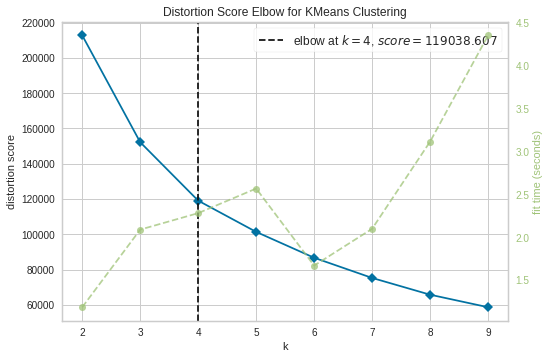

In [25]:
#Elbow Method for K means 
# Import ElbowVisualizer
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model = KMeans(init = 'k-means++',random_state=39)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,10), timings= True)
visualizer.fit(pca2d_RFM)        # Fit data to visualizer
visualizer.show()

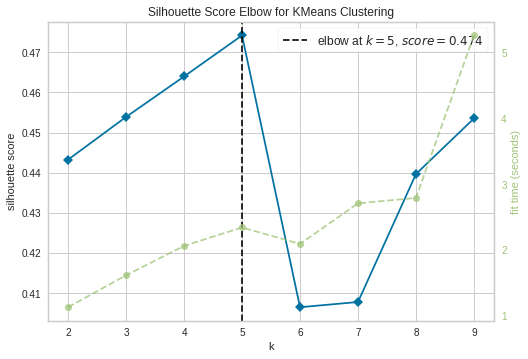

In [27]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model =  KMeans(init = 'k-means++',random_state=39)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,10),metric='silhouette', timings= True)
visualizer.fit(pca2d_RFM)        # Fit the data to the visualizer
visualizer.show()  

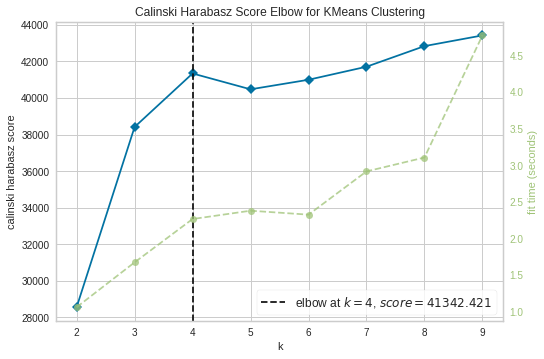

In [28]:
# Calinski Harabasz Score for K means
# Import ElbowVisualizer
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(init = 'k-means++',random_state=39)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,10),metric='calinski_harabasz', timings= True)
visualizer.fit(pca2d_RFM)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

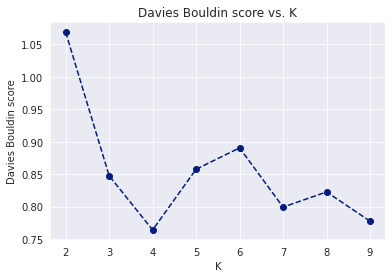

In [9]:
# Davies Bouldin score for K means
scores = []
centers = list(range(2,10))
for center in centers:
    scores.append(get_kmeans_score(pca2d_RFM, center))
    
plt.plot(centers, scores, linestyle='--', marker='o', color='b');
plt.xlabel('K');
plt.ylabel('Davies Bouldin score');
plt.title('Davies Bouldin score vs. K');

## Stabilité à l'initialisation 

- [X] Kmeans n_clusters = 4 , random_state = None 

> Stabilité moyenne pour 10 itérations 



In [11]:
# Choix du nombre de clusters
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=4,  init = 'k-means++', random_state=39)
kmeans.fit(pca2d_RFM)

#Les prédictions 
clusters_kmeans_true = kmeans.labels_
clusters_kmeans_true

array([1, 2, 2, ..., 2, 1, 2], dtype=int32)

In [12]:
# 10 modèles random Kmeans n_clusters=4,  init = 'k-means++'
Kmeans_1 = KMeans(n_clusters=4,  init = 'k-means++', random_state=None)
Kmeans_2 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_3 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_4 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_5 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_6 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_7 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_8 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_9 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)
Kmeans_10 = KMeans(n_clusters=4, init = 'k-means++', random_state=None)

#dictionnaire pour itération avec les modèles kmeans random
dict_of_models = {'Iter_1': Kmeans_1,
                  'Iter_2' : Kmeans_2,
                  'Iter_3': Kmeans_3,
                  'Iter_4' : Kmeans_4,
                  'Iter_5': Kmeans_5,
                  'Iter_6' : Kmeans_6,
                  'Iter_7': Kmeans_7,
                  'Iter_8' : Kmeans_8,
                  'Iter_9': Kmeans_9,
                  'Iter_10' : Kmeans_10
                  
                 }

# boucle pour afficher chaque modèles random Kmeans afin de voir la stabilité du modèle kmeans true
score_stability = {}
for name, model in dict_of_models.items():
  
  print(7*('-'))
  print(f'{name}(n_cluster 4):')
  print(7*('-'))
  stability_init(model,X_scaled_RFM, clusters_kmeans_true)

-------
Iter_1(n_cluster 4):
-------
Fit_time:  9.5367431640625e-07
Le score ARI  0.974498183598286
Le score HOMO  0.950194099348993
Le score AMI 0.9366631478589138
-------
Iter_2(n_cluster 4):
-------
Fit_time:  2.384185791015625e-07
Le score ARI  0.9753530649048179
Le score HOMO  0.9513864993737546
Le score AMI 0.9385792161264854
-------
Iter_3(n_cluster 4):
-------
Fit_time:  4.76837158203125e-07
Le score ARI  0.974498183598286
Le score HOMO  0.9501940993489927
Le score AMI 0.9366631478589136
-------
Iter_4(n_cluster 4):
-------
Fit_time:  4.76837158203125e-07
Le score ARI  0.974498183598286
Le score HOMO  0.950194099348993
Le score AMI 0.9366631478589138
-------
Iter_5(n_cluster 4):
-------
Fit_time:  4.76837158203125e-07
Le score ARI  0.974498183598286
Le score HOMO  0.9501940993489929
Le score AMI 0.9366631478589137
-------
Iter_6(n_cluster 4):
-------
Fit_time:  7.152557373046875e-07
Le score ARI  0.9732794576048344
Le score HOMO  0.946787602477041
Le score AMI 0.936186827208073

## Distance intercluster

- [X]  Les clusters (1 et 2) trop similaire en terme F,M
-Cluster 3 suffisamment distant mais trop peu de clients 


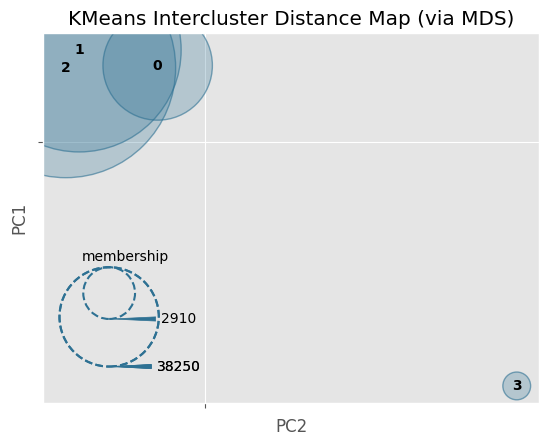

In [92]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import InterclusterDistance

# Instantiate the clustering model and visualizer
model = KMeans(4, random_state=39, init = 'k-means++')
visualizer = InterclusterDistance(model)

visualizer.fit(pca2d_RFM)        # Fit the data to the visualizer
visualizer.show() 

## Analyse des clusters RFM 



- pas homogène

> cluster 0 : 2910

> cluster 1 : 38250

> cluster 2 : 51547

> cluster 3 : 38


- pas pertinent pour le besoin métier 
- La fréquence à trop de poids dans la segmentation (97% clients ont passé 1 commande)


In [13]:
# Add labels clusters
X_scaled_clustered_kmeans = pd.DataFrame(X_scaled_RFM, columns=df_RFM.columns, index=
                                         df_RFM.index)
X_scaled_clustered_kmeans['cluster'] = clusters_kmeans_true
X_scaled_clustered_kmeans 

,recence,frequence,Monnaie,cluster
customer_unique_id,,,,
1,1.518537,-0.281762,-0.123550,1
2,-0.063335,-0.281762,0.240407,2
3,-0.896936,-0.281762,-0.102594,2
4,-0.457162,-0.281762,-0.072549,2
5,-1.362964,-0.281762,0.079799,2
...,...,...,...,...
96092,-0.621257,-0.281762,-0.235646,2
96093,-0.601565,-0.281762,-0.157918,2
96094,-0.627820,-0.281762,-0.298823,2


In [14]:
#Création dataframe pour les clusters 
segmen_kmeans = pd.DataFrame(clusters_kmeans_true)
DF_kmeans = df_RFM.reset_index()
DF1_kmeans= pd.concat([DF_kmeans, segmen_kmeans], axis=1)
DF2_kmeans = DF1_kmeans.rename(columns={0:'cluster'})
DF2_kmeans

,customer_unique_id,recence,frequence,Monnaie,cluster
0,1,470.0,1.0,146.87,1
1,2,229.0,1.0,335.48,2
2,3,102.0,1.0,157.73,2
3,4,169.0,1.0,173.30,2
4,5,31.0,1.0,252.25,2
...,...,...,...,...,...
92740,96092,144.0,1.0,88.78,2
92741,96093,147.0,1.0,129.06,2
92742,96094,143.0,1.0,56.04,2
92743,96095,299.0,1.0,711.07,1


In [15]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_kmeans = DF2_kmeans.groupby('cluster').mean()
centroide_kmeans

,customer_unique_id,recence,frequence,Monnaie
cluster,,,,
0,43839.820962,249.813048,4.300687,1306.798141
1,48067.838013,386.992003,1.143686,168.939524
2,48247.779560,127.964487,1.127728,168.312085
3,43935.210526,208.732632,11.868421,16286.380000


In [16]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_kmeans = X_scaled_clustered_kmeans.groupby('cluster').mean()
centroide_kmeans

,recence,frequence,Monnaie
cluster,,,
0,0.073277,3.621473,2.114741
1,0.973690,-0.111846,-0.080963
2,-0.726510,-0.130717,-0.082174
3,-0.196366,12.570715,31.020553


In [17]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_kmeans = X_scaled_clustered_kmeans.groupby('cluster').mean()
centroide_kmeans

,recence,frequence,Monnaie
cluster,,,
0,0.073277,3.621473,2.114741
1,0.973690,-0.111846,-0.080963
2,-0.726510,-0.130717,-0.082174
3,-0.196366,12.570715,31.020553


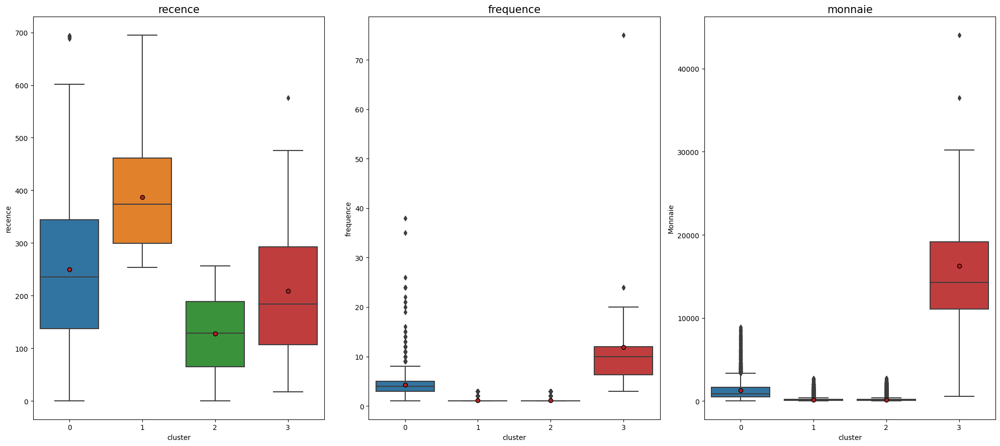

In [18]:
# Comparer chaque clusters pour chaque dimensions
#palette = sns.color_palette("bright", 10)
plt.style.use('default')

meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

_, axes = plt.subplots (1, 3,sharey = False, figsize = (20, 9)) 
sns.boxplot(x = 'cluster', y = 'recence',
            data = DF2_kmeans, showmeans=True,meanprops=meanprops, ax = axes [0])
axes[0].set_title("recence",size=15); 

plt.subplots_adjust(hspace=50)
sns.boxplot(x = 'cluster', y = 'frequence', 
               data =  DF2_kmeans, showmeans=True,meanprops=meanprops, ax = axes [1])
axes[1].set_title("frequence",size=15);
plt.subplots_adjust(hspace=50)

sns.boxplot(x = 'cluster', y = 'Monnaie', 
               data = DF2_kmeans ,showmeans=True,meanprops=meanprops, ax = axes [2])
axes[2].set_title("monnaie",size=15);
plt.subplots_adjust(hspace=50)

plt.tight_layout()

(array([0, 1, 2]), <a list of 3 Text major ticklabel objects>)

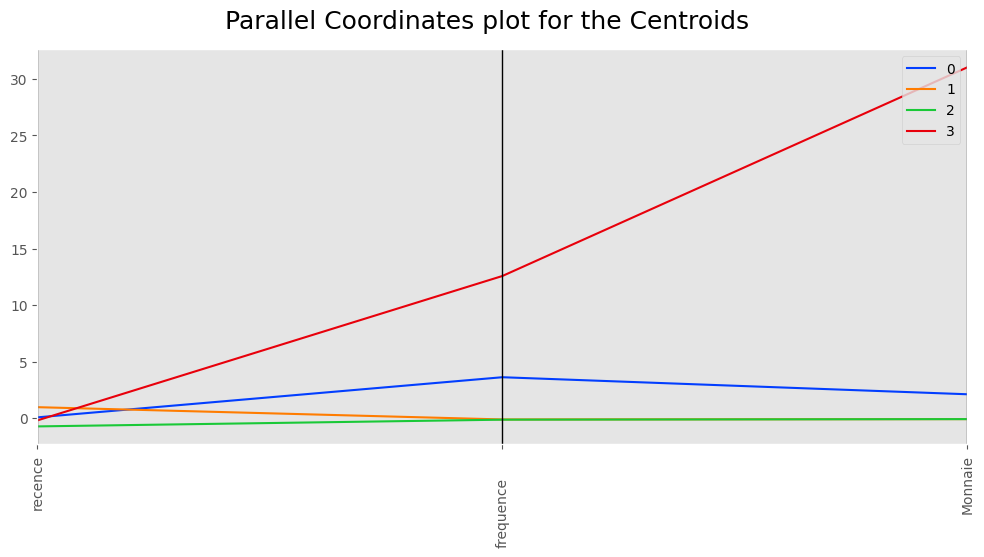

In [19]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
plt.style.use('ggplot')
display_parallel_coordinates_centroids(centroide_kmeans.reset_index(), 4)
plt.xticks(rotation=90)

In [20]:
# afficher les effectifs pour segmentation KMEANS 
for i in range(4):
  print(colored('Les clusters pour segmentation Kmeans', 'blue'))
  print(f"Le nombre de clients dans le cluster {i} :", len(DF2_kmeans[DF2_kmeans['cluster']==i]['customer_unique_id']))
  kmeans_effectif = list(DF2_kmeans[DF2_kmeans['cluster']==i]['customer_unique_id'])

Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 0 : 2910
Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 1 : 38250
Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 2 : 51547
Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 3 : 38


In [101]:
#évalution avec les metrics Silhouette Score,calinski_harabasz Score, davies_bouldin Score
print('Kmeans ACP Scaled Silhouette Score: {}'.format(silhouette_score(pca2d_RFM, clusters_kmeans_true)))
print('Kmeans ACP Scaled calinski_harabasz Score: {}'.format(metrics.calinski_harabasz_score(pca2d_RFM, clusters_kmeans_true)))
print('Kmeans ACP Scaled davies_bouldin Score: {}'.format(davies_bouldin_score(pca2d_RFM, clusters_kmeans_true)))

Kmeans ACP Scaled Silhouette Score: 0.46396978326641786
Kmeans ACP Scaled calinski_harabasz Score: 41342.42135750875
Kmeans ACP Scaled davies_bouldin Score: 0.7640758636417904


### Test kruskal wallis 

- [X] Test non paramètrique 

> Les hypothèses ne sont pas respectées ( variance et normalité)

- [X] Le test indique:

> Il y a au moins un cluster diffèrent des autres pour chaque indicateur R,F,M



In [21]:
#liste des variables 
list_ind = ['recence', 'frequence', 
       'Monnaie']
       

for i in list_ind:
  
  #Sélection nutriscore_score et les groupe nutriscore
  df_kruskall = DF2_kmeans[[i, 'cluster']]
  df_kruskall.head()
  #Les valeurs uniques de colonne groupe nutriscore
  grps = pd.unique(df_kruskall['cluster'].values)
  grps
  
  # création dictionnaire entre groupe nutriscore et nutriscore_score 
  d_data = {grp:df_kruskall[i][df_kruskall['cluster'] == grp].values for grp in grps}
  d_data
  
  from scipy import stats
  
  #Hypothèses
  
  #Les observations dans chaque échantillon sont indépendantes et distribuées de manière identique (iid).
  #Les observations de chaque échantillon peuvent être classées.
  
  
  #Interprétation:
  #H0 : toutes les distributions d'échantillons sont égales.
  #H1 : une ou plusieurs distributions d'échantillon ne sont pas égales.
  
  a = d_data[0]
  b = d_data[1]
  c = d_data[2]
  d = d_data[3]
 
  
  stat, p = stats.kruskal(a, b, c, d)
  print('stat=%.3f, p=%.3f' % (stat, p))
  if p > 0.05:
      print(colored(f'Les clusters sont significativements les memes pour {i}','red'))
  else:
      print(colored(f'Il y a au moins un cluster significativement différent des autres cluster pour {i}', 'blue'))
      


stat=66247.991, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour recence
stat=21011.240, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour frequence
stat=6049.477, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour Monnaie


### Test bonferroni comparaisons multiples par paires

- [X] Le test indique:

Les clusters 1 et 2  non différents pour F,M 


          1             2         3             4
1  1.000000  0.000000e+00  0.000000  6.464256e-01
2  0.000000  1.000000e+00  0.000000  4.592806e-12
3  0.000000  0.000000e+00  1.000000  2.462194e-03
4  0.646426  4.592806e-12  0.002462  1.000000e+00

     1             2             3             4
1  1.0  0.000000e+00  0.000000e+00  1.000000e+00
2  0.0  1.000000e+00  2.142843e-07  1.245891e-67
3  0.0  2.142843e-07  1.000000e+00  2.096753e-69
4  1.0  1.245891e-67  2.096753e-69  1.000000e+00

          1             2             3             4
1  1.000000  0.000000e+00  0.000000e+00  2.976060e-01
2  0.000000  1.000000e+00  1.000000e+00  4.751649e-27
3  0.000000  1.000000e+00  1.000000e+00  6.580161e-27
4  0.297606  4.751649e-27  6.580161e-27  1.000000e+00



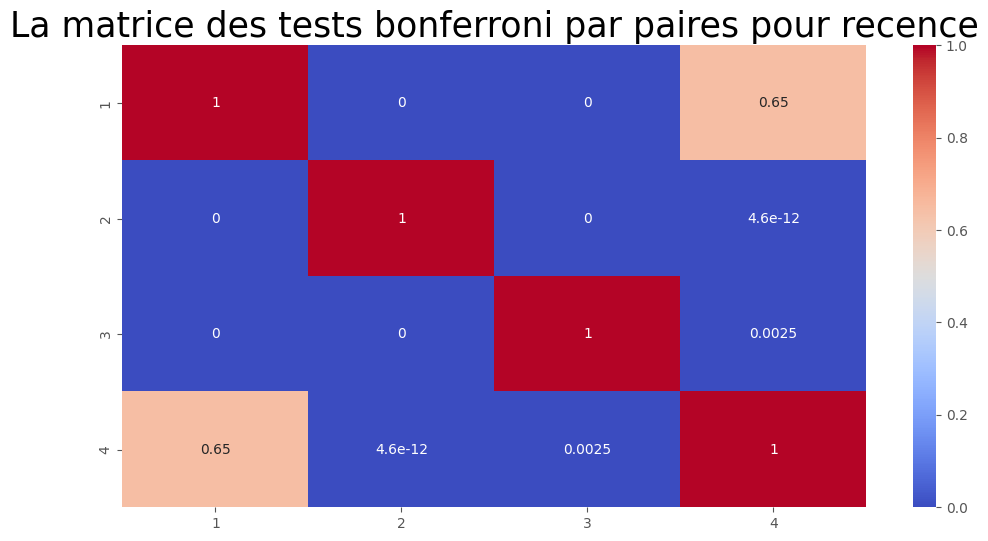

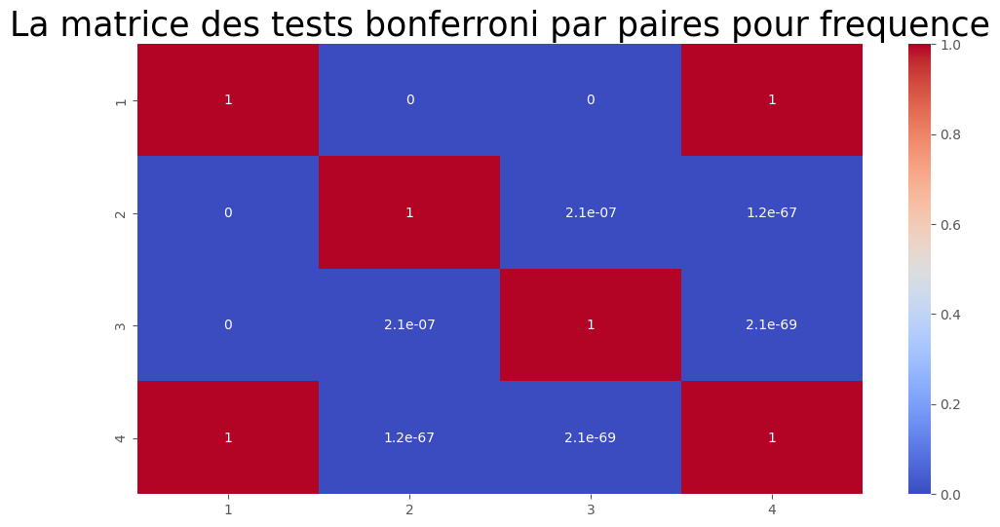

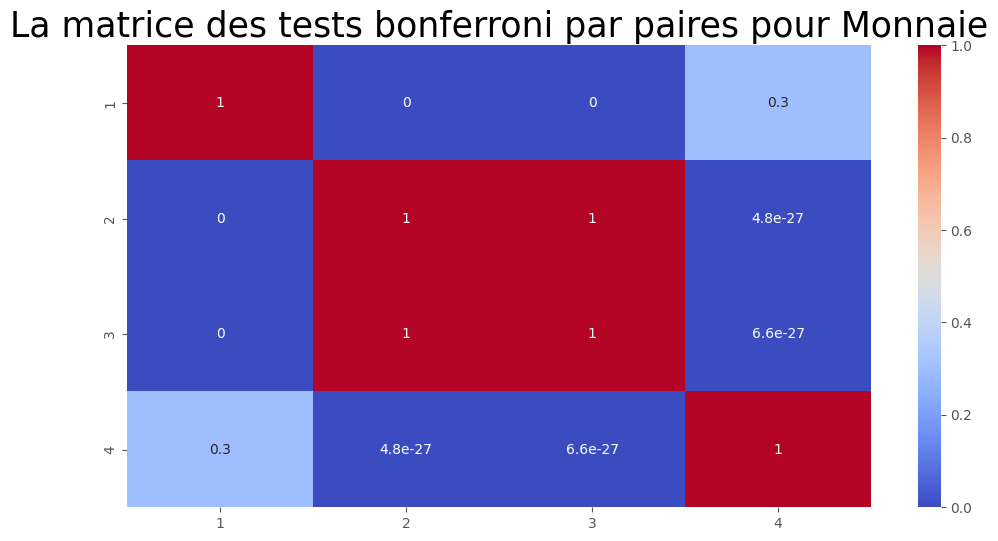

In [22]:
#Test bonferroni comparaisons multiples par paires pour les groupes nutriscore grade


for i in list_ind:
  
  #Sélection nutriscore_score et les groupe nutriscore
  df_kruskall = DF2_kmeans[[i, 'cluster']]
  df_kruskall.head()
  #Les valeurs uniques de colonne groupe nutriscore
  grps = pd.unique(df_kruskall['cluster'].values)
  grps
  
  # création dictionnaire entre groupe nutriscore et nutriscore_score 
  d_data = {grp:df_kruskall[i][df_kruskall['cluster'] == grp].values for grp in grps}
  d_data
  
  from scipy import stats
  

  import scikit_posthocs as sp
  
  data = [d_data[0], d_data[1], d_data[2], d_data[3]]
  bonferroni= sp.posthoc_dunn(data, p_adjust = 'bonferroni')
  print(bonferroni)
  
  # Visualisation de la matrice Test bonferroni comparaisons multiples par paires pour les groupes nutriscore_grade
  plt.figure(figsize=(12,6))
  sns.heatmap(bonferroni, annot=True, cmap='coolwarm')
  plt.title(f'La matrice des tests bonferroni par paires pour {i}', size=25)
  print('')

### ACP visualisation 

- [X] Variance expliquée pour chaque composante 


 > PC1 = 0.48129462 (F,M)
 
 > PC2 = 0.3334091 (R) 
 
 > PC3 = 0.18529628

In [23]:
# supprimer Country Name et mettre les clusters en set_index afin de pouvoir visualiser les clusters 
DF_ACP_KMEANS = DF2_kmeans.drop('customer_unique_id',axis=1).set_index('cluster')
DF_ACP_KMEANS

,recence,frequence,Monnaie
cluster,,,
1,470.0,1.0,146.87
2,229.0,1.0,335.48
2,102.0,1.0,157.73
2,169.0,1.0,173.30
2,31.0,1.0,252.25
...,...,...,...
2,144.0,1.0,88.78
2,147.0,1.0,129.06
2,143.0,1.0,56.04


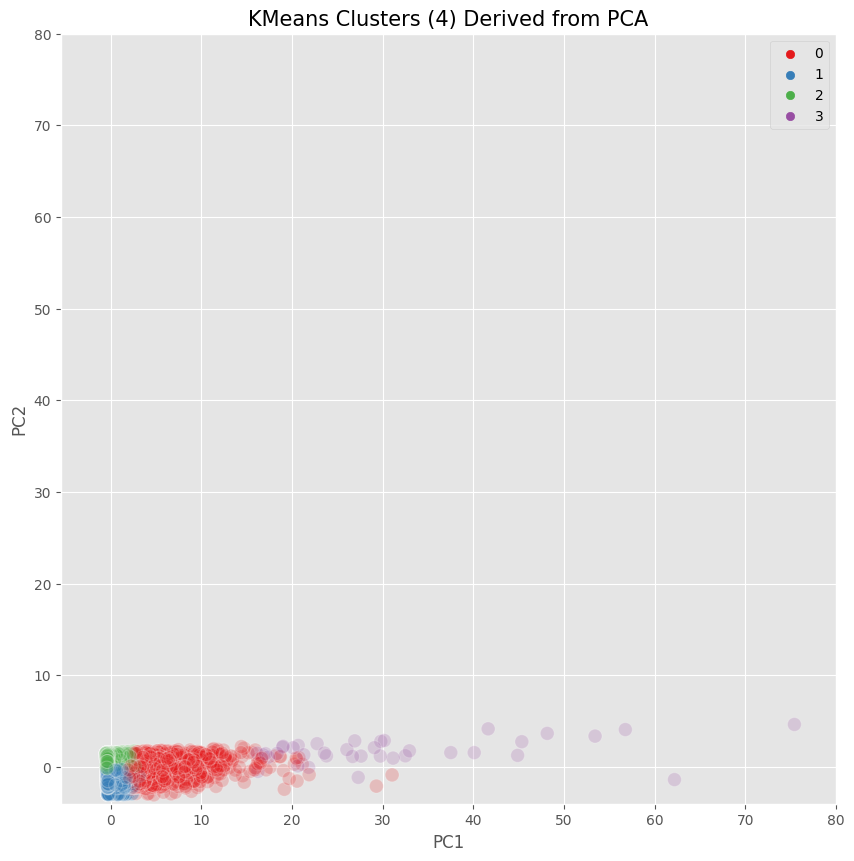

In [24]:
# Visualiser PC1 et PC2 (plot 2D) et color les labels preds
plt.style.use('ggplot')
pca2 = PCA(n_components=0.95).fit(X_scaled_RFM)
pca2d = pca2.transform(X_scaled_RFM)


plt.figure(figsize = (10,10))
sns.scatterplot(pca2d[:,0], pca2d[:,1], 
                hue=clusters_kmeans_true, 
                palette='Set1',
                s=100, alpha=0.2).set_title('KMeans Clusters (4) Derived from PCA', fontsize=15)
plt.legend()
plt.xlim([-5.5, 80])
plt.ylim([-4, 80])
plt.ylabel('PC2')
plt.xlabel('PC1')
plt.show()

In [25]:
from sklearn.preprocessing import StandardScaler
from sklearn import decomposition
from sklearn import preprocessing
# selection des colonnes à prendre en compte dans l'ACP
data_pca = DF_ACP_KMEANS[['recence', 'frequence', 'Monnaie']]
X = data_pca.values
names = DF_ACP_KMEANS.index
features = DF_ACP_KMEANS.columns

# Centrage et Réduction
std_scale = preprocessing.StandardScaler().fit(DF_ACP_KMEANS)
X_scaled = std_scale.transform(DF_ACP_KMEANS)

# Calcul des composantes principales
pca = decomposition.PCA(n_components=0.95)
df_composantes = pca.fit_transform(X_scaled)

In [26]:
#Création df avec les composantes et les labels des clusters 
scores_df = pd.DataFrame(df_composantes, columns=['PC1', 'PC2', 'PC3'])
scores_df_1 = pd.concat([scores_df, DF2_kmeans['cluster']], axis=1)
scores_df_1

,PC1,PC2,PC3,cluster
0,-0.235599,-1.521528,-0.173359,1
1,-0.031601,0.077192,-0.366387,2
2,-0.301787,0.891706,-0.090515,2
3,-0.265824,0.454111,-0.129505,2
4,-0.188601,1.366630,-0.200456,2
...,...,...,...,...
92740,-0.386509,0.609450,-0.007718,2
92741,-0.330955,0.593851,-0.063393,2
92742,-0.431347,0.612702,0.037154,2
92743,0.495658,-0.343739,-0.896682,1


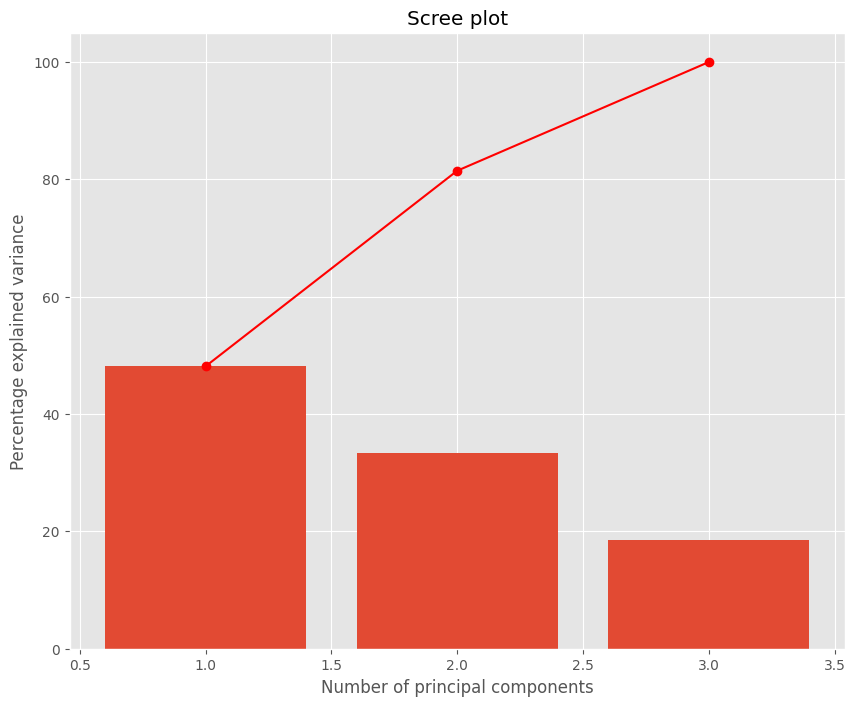

In [29]:
# Eboulis des valeurs propres
plt.figure(figsize=(10,8))
display_scree_plot(pca)

In [30]:
import plotly.express as px
# Plot 3D les 3 composantes et color les labels pred 
fig = px.scatter_3d(scores_df_1, x='PC1', y='PC2', z='PC3',
              color='cluster')

fig.show()

<Figure size 1500x1200 with 0 Axes>

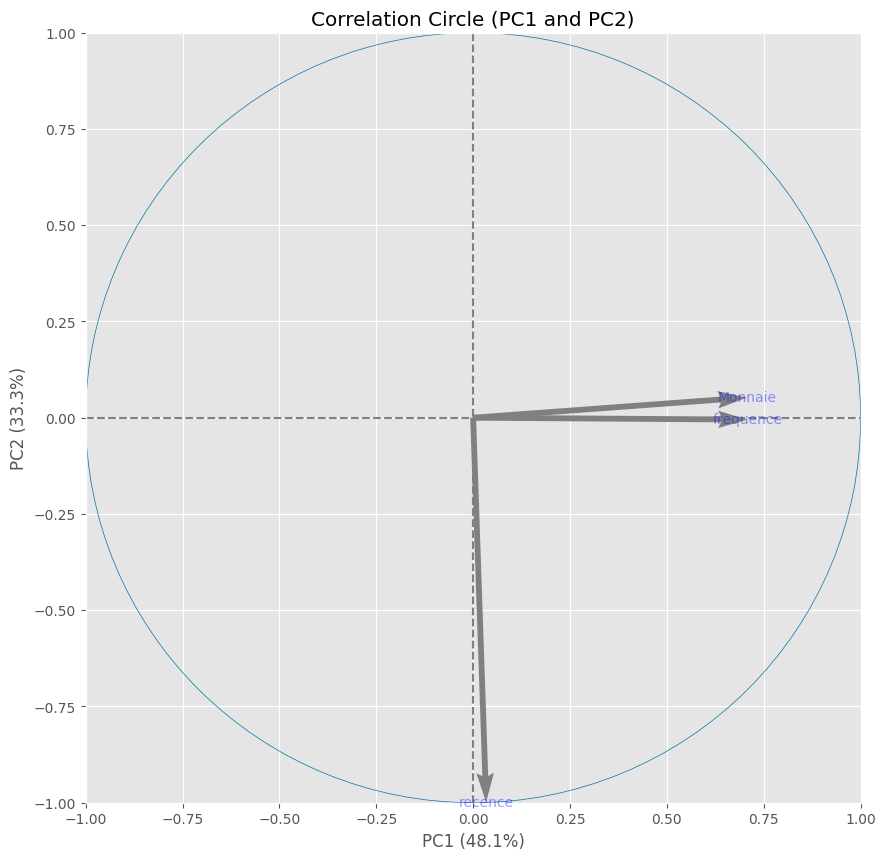

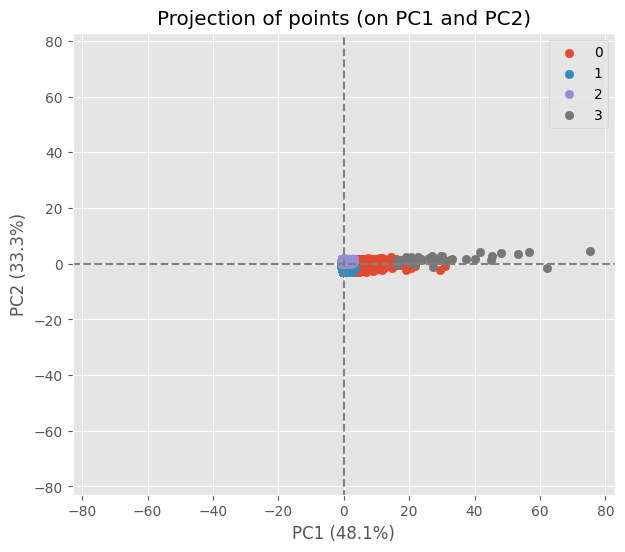

In [57]:
# Cercle des corrélations
plt.figure(figsize=(15,12))
pcs = pca.components_
display_circles(pcs,3, pca, [(0,1),(2,3),(4,5)], labels = np.array(features))

display_factorial_planes(df_composantes, 2, pca, [(0,1)], illustrative_var = names, alpha = 1)
plt.show()

# KMEANS (RFM, mean satisfaction, mean items, mean durée livraison) 

- [X] Les variables pour la segmentation:

> (RFM, mean satisfaction, mean items, mean durée livraison) 

## Recherche best K 


- [X] mise à l'échelle 

> Standarscaler

- [X] PCA 

PC1 = 0.36129161
PC2 =  0.22288263
PC3 =  0.16604472 
PC4 = 0.10984229 
PC5 = 0.09246442




- [X] méthode du coude (Distortion)

La moyenne de la somme des carrés des distances au centroide le proche
(coude)



> K= 5

- [X] davies_bouldin_score



Le score est défini comme la mesure de similarité moyenne de chaque cluster avec son cluster le plus similaire, où la similarité est le rapport des distances intra-cluster aux distances inter-cluster. Ainsi, les clusters plus éloignés et moins dispersés donneront un meilleur score.

Le score minimum est de zéro, les valeurs inférieures indiquant un meilleur regroupement.



> K= 2

- [X] silhouette score

Le coefficient de silhouette ou score de silhouette est une mesure utilisée pour calculer la qualité d'une technique de regroupement. Sa valeur est comprise entre -1 et 1 . 1 : Signifie que les grappes sont bien séparées les unes des autres et clairement distinguées. ... a= distance intra-cluster moyenne, c'est-à-dire la distance moyenne entre chaque point d'un cluster.


K= 2,3


Silhouette score : 0.66 , 0.40




- [X] calinski_harabasz 

Il est également connu sous le nom de critère du rapport de variance.

Le score est défini comme le rapport entre la dispersion intra-cluster et la dispersion inter-cluster.

> k = 4 


 
- [X] Il y a des divergences pour les metrics 
            
> Le choix se porte sur K = 3 car maximisation de la metrics silhouette score (0.40)

In [35]:
# Standardisation des données 
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_segmentation)
X_scaled.shape

(92745, 6)

In [36]:
from sklearn import decomposition

pca2 = decomposition.PCA(n_components=0.95).fit(X_scaled)
pca2 = pca2.fit(X_scaled)
pca2d = pca2.transform(X_scaled)


print("La variance expliquée pour chaque composante: ", pca2.explained_variance_ratio_)
print("La somme cumulé des composantes: ", pca2.explained_variance_ratio_.sum())

La variance expliquée pour chaque composante:  [0.36129161 0.22288263 0.16604472 0.10984229 0.09246442]
La somme cumulé des composantes:  0.9525256594244649


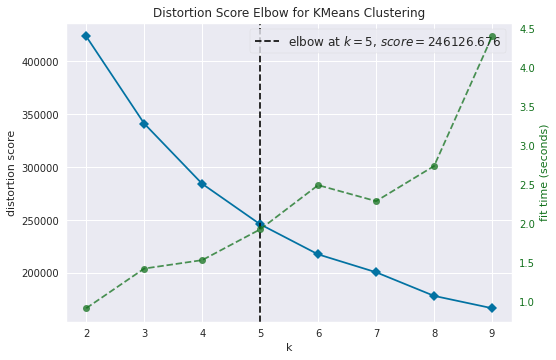

In [ ]:
#Elbow Method for K means (recence	frequence	Monnaie	review_score_mean	Duration_delevery_order_mean)
# Import ElbowVisualizer
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model = KMeans(init = 'k-means++',random_state=39)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,10), timings= True)
visualizer.fit(pca2d)        # Fit data to visualizer
visualizer.show()  

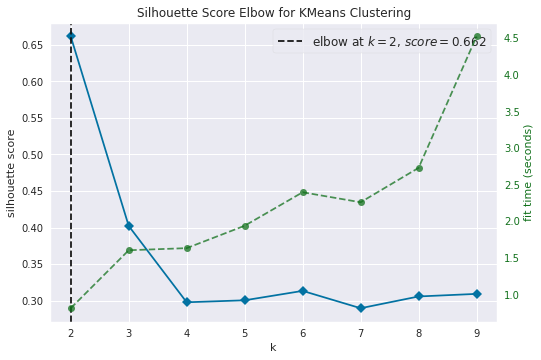

In [ ]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model =  KMeans(init = 'k-means++',random_state=39)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,10),metric='silhouette', timings= True)
visualizer.fit(pca2d)        # Fit the data to the visualizer
visualizer.show()  

For n_clusters = 2 The average silhouette_score is : 0.6616688220635374
For n_clusters = 3 The average silhouette_score is : 0.4021399554068289
For n_clusters = 4 The average silhouette_score is : 0.2976307795378659
For n_clusters = 5 The average silhouette_score is : 0.30035260918782986
For n_clusters = 6 The average silhouette_score is : 0.3132367910573718
For n_clusters = 7 The average silhouette_score is : 0.2895112372310878
For n_clusters = 8 The average silhouette_score is : 0.30559061888259786
For n_clusters = 9 The average silhouette_score is : 0.30913490736125493
For n_clusters = 10 The average silhouette_score is : 0.26931401715110376


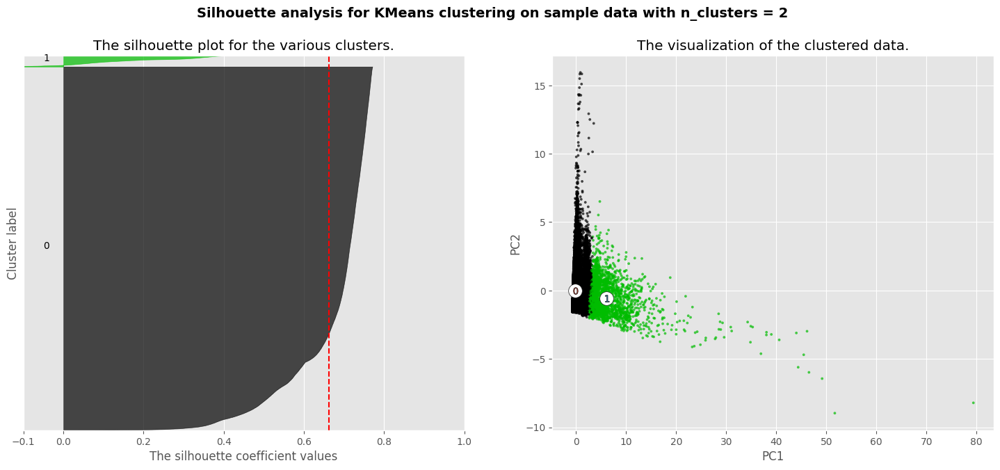

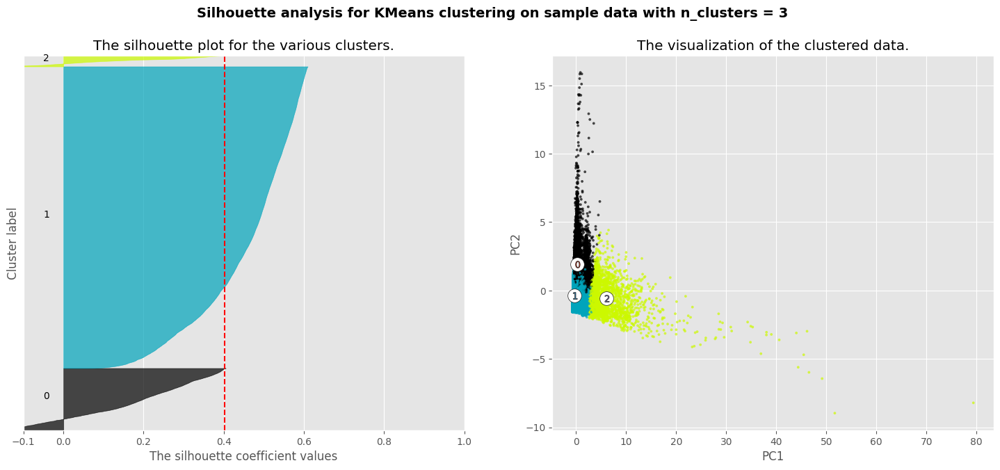

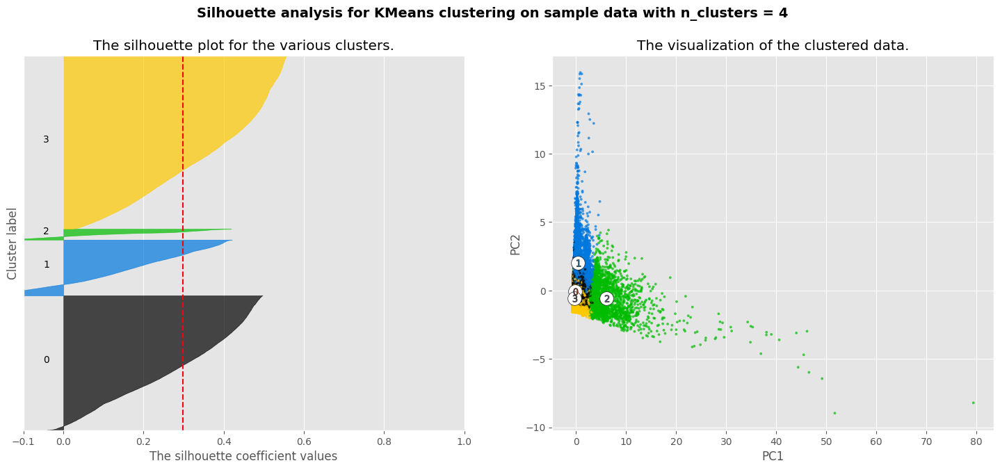

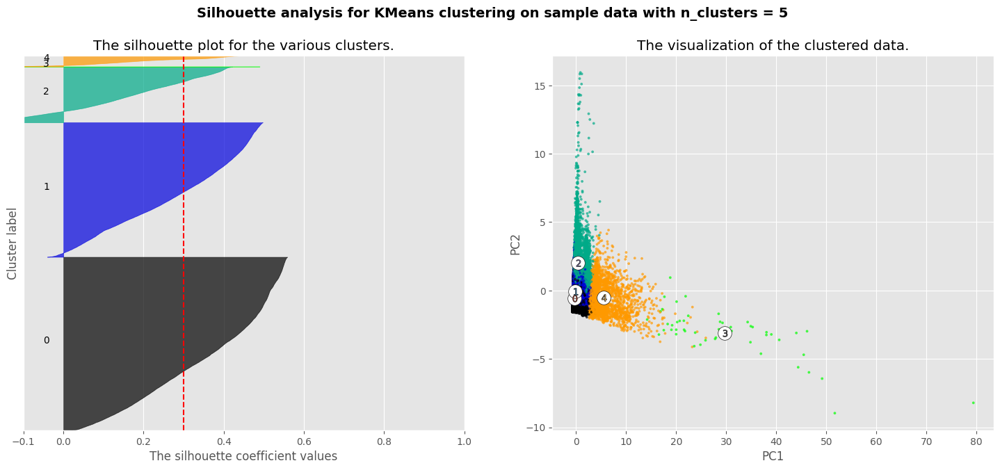

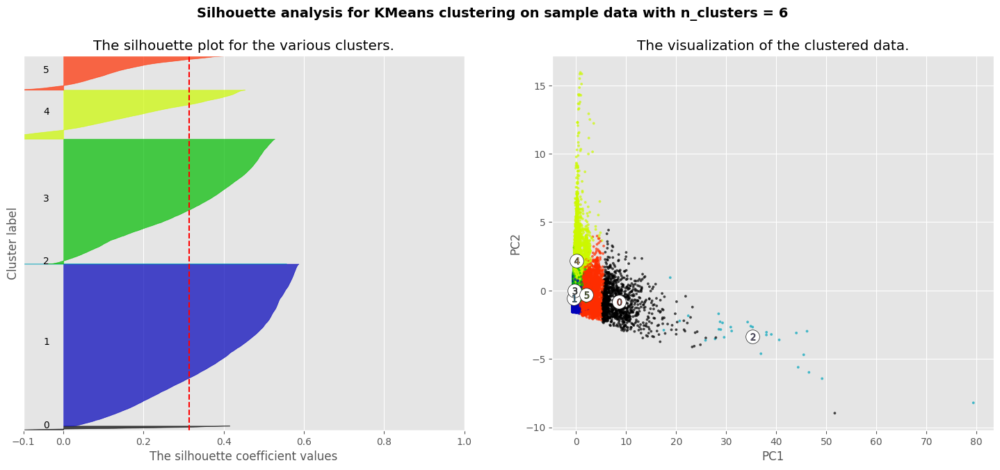

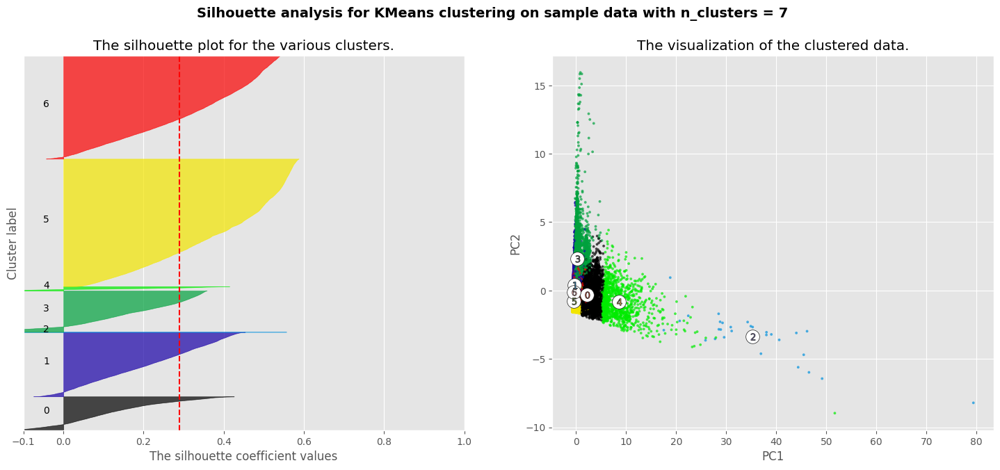

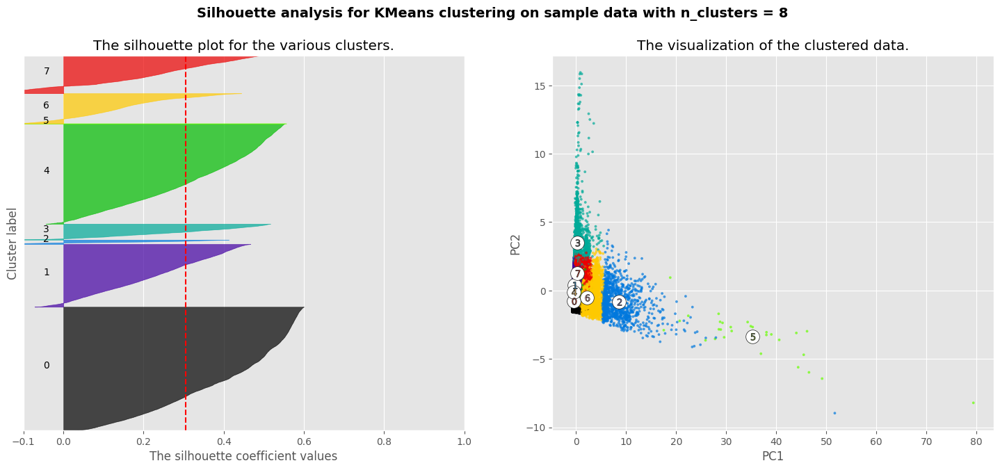

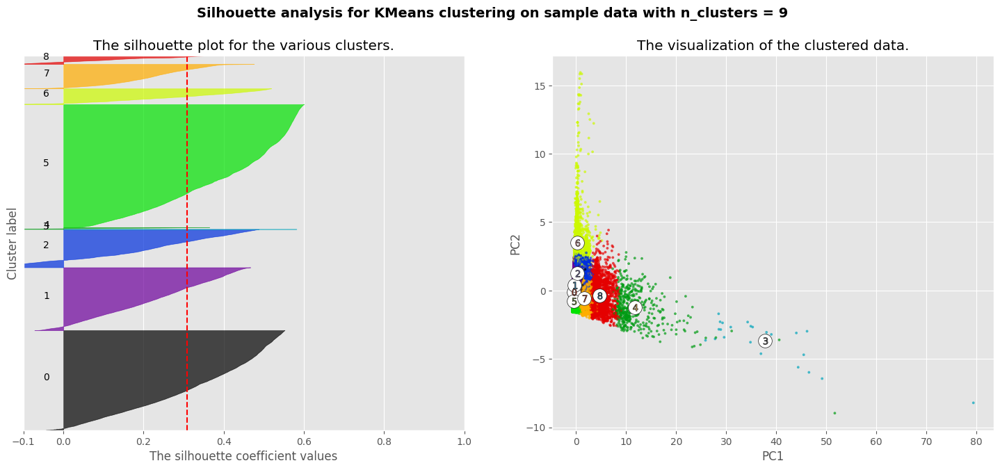

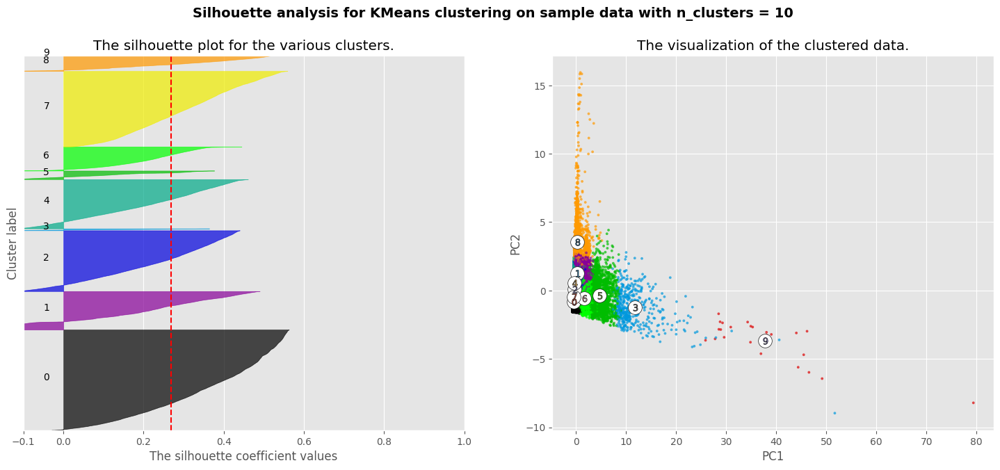

In [41]:
# plot silhouette fonction pour élement range_n_clusters
range_n_clusters = [2,3,4,5,6,7,8,9,10]
silhouette_score_plot(range_n_clusters, pca2d)

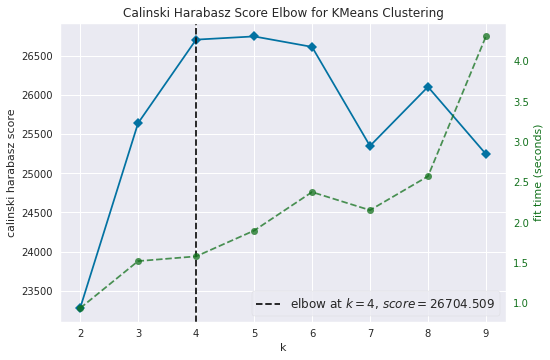

In [ ]:
# Calinski Harabasz Score for K means
# Import ElbowVisualizer
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(init = 'k-means++',random_state=39)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,10),metric='calinski_harabasz', timings= True)
visualizer.fit(pca2d)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

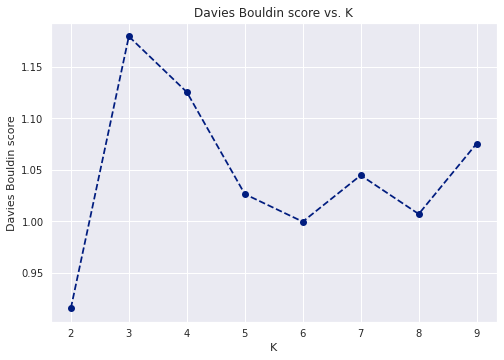

In [ ]:
# Davies Bouldin score for K means
scores = []
centers = list(range(2,10))
for center in centers:
    scores.append(get_kmeans_score(pca2d, center))
    
plt.plot(centers, scores, linestyle='--', marker='o', color='b');
plt.xlabel('K');
plt.ylabel('Davies Bouldin score');
plt.title('Davies Bouldin score vs. K');

## Stabilité Kmeans à l'initialisation

- [X] Kmeans n_clusters = 3 , random_state = None 

> Stabilité stable pour 10 itérations 


In [42]:
# Choix du nombre de clusters
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3,  init = 'k-means++', random_state=39)
kmeans.fit(pca2d)

KMeans(n_clusters=3, random_state=39)

In [43]:
#Les prédictions 
clusters_kmeans_true = kmeans.labels_
clusters_kmeans_true

array([1, 1, 1, ..., 0, 1, 1], dtype=int32)

In [72]:
# 10 modèles random Kmeans n_clusters=4,  init = 'k-means++'
Kmeans_1 = KMeans(n_clusters=3,  init = 'k-means++', random_state=None)
Kmeans_2 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_3 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_4 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_5 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_6 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_7 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_8 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_9 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)
Kmeans_10 = KMeans(n_clusters=3, init = 'k-means++', random_state=None)

#dictionnaire pour itération avec les modèles kmeans random
dict_of_models = {'Iter_1': Kmeans_1,
                  'Iter_2' : Kmeans_2,
                  'Iter_3': Kmeans_3,
                  'Iter_4' : Kmeans_4,
                  'Iter_5': Kmeans_5,
                  'Iter_6' : Kmeans_6,
                  'Iter_7': Kmeans_7,
                  'Iter_8' : Kmeans_8,
                  'Iter_9': Kmeans_9,
                  'Iter_10' : Kmeans_10
                  
                 }
# boucle pour afficher chaque modèles random Kmeans afin de voir la stabilité du modèle kmeans true
score_stability = []
for name, model in dict_of_models.items():
  
  print(7*('-'))
  print(f'{name}(n_cluster 3):')
  print(7*('-'))
  stability_init(model,pca2d, clusters_kmeans_true)
 
  #score_stability.append(score)
 #


-------
Iter_1(n_cluster 3):
-------
Fit_time:  2.384185791015625e-07
Le score ARI  0.9999521516389113
Le score HOMO  0.9997709474649992
Le score AMI 0.9997857656100236
-------
Iter_2(n_cluster 3):
-------
Fit_time:  7.152557373046875e-07
Le score ARI  0.9959405702565177
Le score HOMO  0.9901246797240195
Le score AMI 0.9888804399395965
-------
Iter_3(n_cluster 3):
-------
Fit_time:  9.5367431640625e-07
Le score ARI  0.9999521516389113
Le score HOMO  0.9997709474649992
Le score AMI 0.9997857656100236
-------
Iter_4(n_cluster 3):
-------
Fit_time:  4.76837158203125e-07
Le score ARI  0.999904303273828
Le score HOMO  0.9995678771782378
Le score AMI 0.9995975095952087
-------
Iter_5(n_cluster 3):
-------
Fit_time:  2.384185791015625e-07
Le score ARI  0.9964650441254504
Le score HOMO  0.991210947206712
Le score AMI 0.9901260596176928
-------
Iter_6(n_cluster 3):
-------
Fit_time:  7.152557373046875e-07
Le score ARI  0.9999521516389113
Le score HOMO  0.9997709474649992
Le score AMI 0.99978576

### InterclusterDistance

- [X] La distance intercluster permet de voir une dissimilarité pour les clusters 

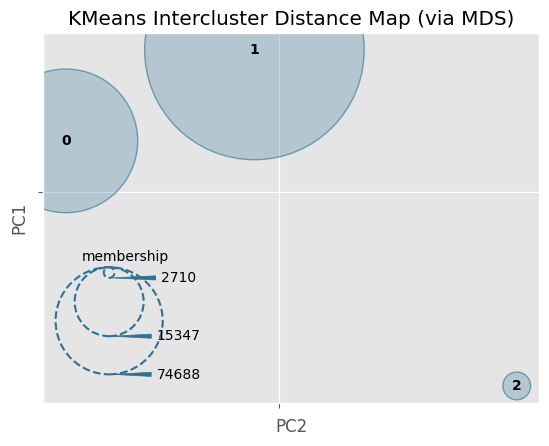

In [ ]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import InterclusterDistance

# Instantiate the clustering model and visualizer
model = KMeans(3, random_state=39, init = 'k-means++')
visualizer = InterclusterDistance(model)

visualizer.fit(pca2d)        # Fit the data to the visualizer
visualizer.show() 

## Analyse des clusters 

- [X] Effectifs des clusters 

> Cluster 0: 15347 clients

> Cluster 1: 74688 clients

> Cluster 2:  2710 clients





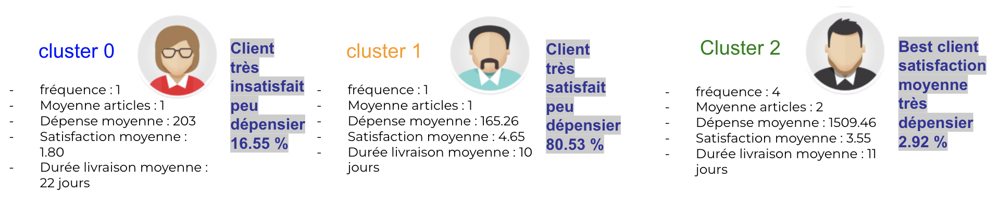

In [ ]:
# Add labels clusters
X_scaled_clustered_kmeans = pd.DataFrame(X_scaled, columns=df_segmentation.columns, index=
                                         df_segmentation.index)
X_scaled_clustered_kmeans['cluster'] = clusters_kmeans_true
X_scaled_clustered_kmeans 

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
customer_unique_id,,,,,,,
1,1.518537,-0.281762,-0.265945,-0.123550,-0.119799,-0.365816,1
2,-0.063335,-0.281762,-0.265945,0.240407,0.661153,0.478991,1
3,-0.896936,-0.281762,-0.265945,-0.102594,0.661153,1.429399,1
4,-0.457162,-0.281762,-0.265945,-0.072549,0.661153,0.267789,1
5,-1.362964,-0.281762,-0.265945,0.079799,0.661153,-0.154614,1
...,...,...,...,...,...,...,...
96092,-0.621257,-0.281762,-0.265945,-0.235646,-0.119799,-0.682618,1
96093,-0.601565,-0.281762,-0.265945,-0.157918,0.661153,-0.577017,1
96094,-0.627820,-0.281762,-0.265945,-0.298823,-2.462655,1.957403,0


In [ ]:
#Création dataframe pour les clusters 
segmen_kmeans = pd.DataFrame(clusters_kmeans_true)
DF_kmeans = df_segmentation.reset_index()
DF1_kmeans= pd.concat([DF_kmeans, segmen_kmeans], axis=1)
DF2_kmeans = DF1_kmeans.rename(columns={0:'cluster'})
DF2_kmeans

,customer_unique_id,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
0,1,470.0,1.0,1.0,146.87,4.0,9.0,1
1,2,229.0,1.0,1.0,335.48,5.0,17.0,1
2,3,102.0,1.0,1.0,157.73,5.0,26.0,1
3,4,169.0,1.0,1.0,173.30,5.0,15.0,1
4,5,31.0,1.0,1.0,252.25,5.0,11.0,1
...,...,...,...,...,...,...,...,...
92740,96092,144.0,1.0,1.0,88.78,4.0,6.0,1
92741,96093,147.0,1.0,1.0,129.06,5.0,7.0,1
92742,96094,143.0,1.0,1.0,56.04,1.0,31.0,0
92743,96095,299.0,1.0,1.0,711.07,5.0,13.0,1


In [ ]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_kmeans = DF2_kmeans.groupby('cluster').mean()
centroide_kmeans

,customer_unique_id,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean
cluster,,,,,,,
0,48218.256272,246.213653,1.209618,1.069827,203.734319,1.801987,22.017814
1,48082.669184,236.951163,1.128079,1.030485,165.261978,4.658223,10.529998
2,45631.933210,242.608070,4.437269,2.172312,1509.146723,3.556715,11.665819


In [ ]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_kmeans = X_scaled_clustered_kmeans.groupby('cluster').mean()
centroide_kmeans

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean
cluster,,,,,,
0,0.049652,-0.033879,-0.002009,-0.013820,-1.836342,1.008876
1,-0.011145,-0.130302,-0.150718,-0.088060,0.394242,-0.204247
2,0.025985,3.782989,4.165189,2.505209,-0.465983,-0.084303


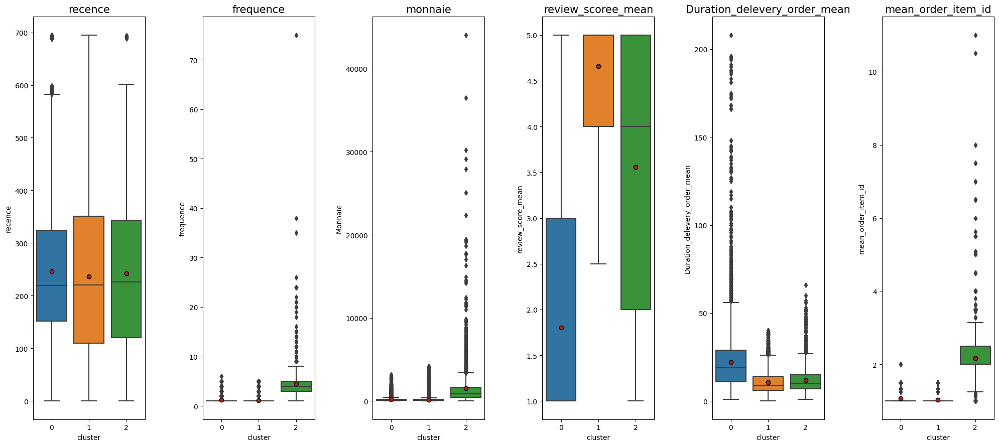

In [ ]:
# Comparer chaque clusters pour chaque dimensions
#palette = sns.color_palette("bright", 10)
plt.style.use('default')

meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

_, axes = plt.subplots (1, 6,sharey = False, figsize = (20, 9)) 
sns.boxplot(x = 'cluster', y = 'recence',
            data = DF2_kmeans, showmeans=True,meanprops=meanprops, ax = axes [0])
axes[0].set_title("recence",size=15); 

plt.subplots_adjust(hspace=50)
sns.boxplot(x = 'cluster', y = 'frequence', 
               data =  DF2_kmeans, showmeans=True,meanprops=meanprops, ax = axes [1])
axes[1].set_title("frequence",size=15);
plt.subplots_adjust(hspace=50)

sns.boxplot(x = 'cluster', y = 'Monnaie', 
               data = DF2_kmeans ,showmeans=True,meanprops=meanprops, ax = axes [2])
axes[2].set_title("monnaie",size=15);
plt.subplots_adjust(hspace=50)


sns.boxplot(x = 'cluster', y = 'review_score_mean', 
               data = DF2_kmeans ,showmeans=True,meanprops=meanprops, ax = axes [3])
axes[3].set_title("review_scoree_mean", size=15);


sns.boxplot(x = 'cluster', y = 'Duration_delevery_order_mean', 
             data = DF2_kmeans  ,showmeans=True,meanprops=meanprops, ax = axes [4])
axes[4].set_title("Duration_delevery_order_mean", size=15);

sns.boxplot(x = 'cluster', y = 'mean_order_item_id', 
            data =DF2_kmeans  ,showmeans=True,meanprops=meanprops, ax = axes [5])
axes[5].set_title("mean_order_item_id", size=15);

plt.tight_layout()


(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

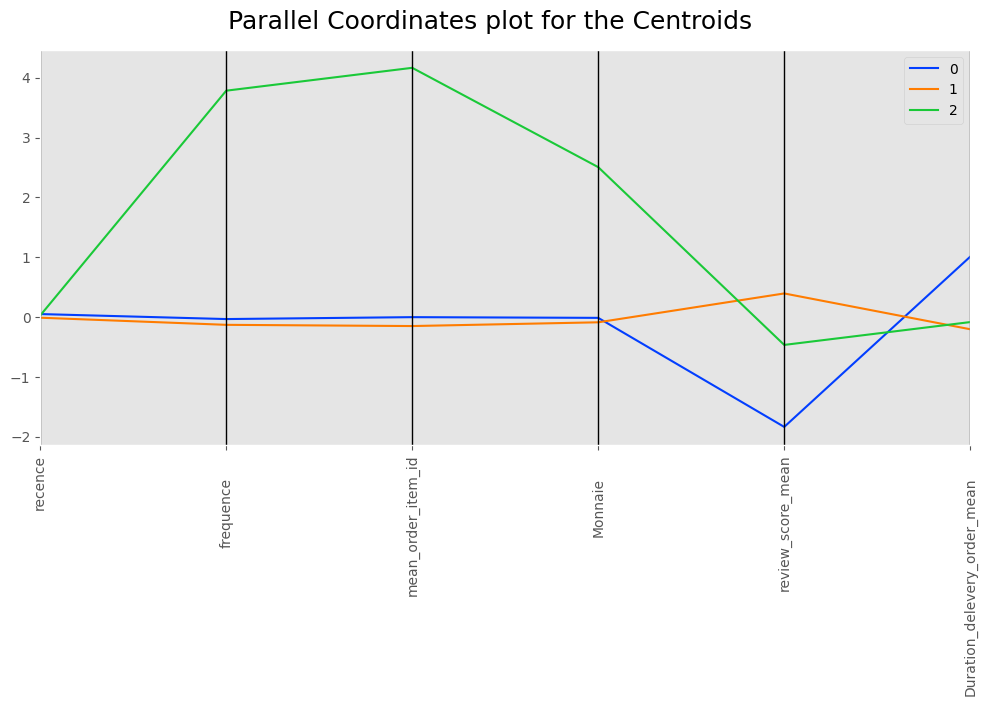

In [ ]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
plt.style.use('ggplot')
display_parallel_coordinates_centroids(centroide_kmeans.reset_index(), 4)
plt.xticks(rotation=90)

In [ ]:
# afficher les effectifs pour segmentation KMEANS 
for i in range(4):
  print(colored('Les clusters pour segmentation Kmeans', 'blue'))
  print(f"Le nombre de clients dans le cluster {i} :", len(DF2_kmeans[DF2_kmeans['cluster']==i]['customer_unique_id']))
  kmeans_effectif = list(DF2_kmeans[DF2_kmeans['cluster']==i]['customer_unique_id'])
  

Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 0 : 15347
Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 1 : 74688
Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 2 : 2710
Les clusters pour segmentation Kmeans
Le nombre de clients dans le cluster 3 : 0


In [ ]:
#évalution avec les metrics Silhouette Score,calinski_harabasz Score, davies_bouldin Score
print('Kmeans ACP Scaled Silhouette Score: {}'.format(silhouette_score(pca2d, clusters_kmeans_true)))
print('Kmeans ACP Scaled calinski_harabasz Score: {}'.format(metrics.calinski_harabasz_score(pca2d, clusters_kmeans_true)))
print('Kmeans ACP Scaled davies_bouldin Score: {}'.format(davies_bouldin_score(pca2d, clusters_kmeans_true)))

Kmeans ACP Scaled Silhouette Score: 0.2976307795378659
Kmeans ACP Scaled calinski_harabasz Score: 26704.508720472844
Kmeans ACP Scaled davies_bouldin Score: 1.1255535946736686


### Test kruskal wallis 


- [X] Test non paramètrique 

> Les hypothèses ne sont pas respectées ( variance et normalité)

- [X] Le test indique:

> Il y a au moins un cluster diffèrent des autres pour chaque indicateur R,F,M,  mean satisfaction, mean items, mean durée livraison 



In [ ]:
#Liste des variables 
list_ind = ['recence', 'frequence', 
       'Monnaie', 'review_score_mean', 'Duration_delevery_order_mean', 'mean_order_item_id']
       

for i in list_ind:
  
  #Sélection nutriscore_score et les groupe nutriscore
  df_kruskall = DF2_kmeans[[i, 'cluster']]
  df_kruskall.head()
  #Les valeurs uniques de colonne groupe nutriscore
  grps = pd.unique(df_kruskall['cluster'].values)
  grps
  
  # création dictionnaire entre groupe nutriscore et nutriscore_score 
  d_data = {grp:df_kruskall[i][df_kruskall['cluster'] == grp].values for grp in grps}
  d_data
  
  from scipy import stats
  
  #Hypothèses
  
  #Les observations dans chaque échantillon sont indépendantes et distribuées de manière identique (iid).
  #Les observations de chaque échantillon peuvent être classées.
  
  
  #Interprétation:
  #H0 : toutes les distributions d'échantillons sont égales.
  #H1 : une ou plusieurs distributions d'échantillon ne sont pas égales.
  
  a = d_data[0]
  b = d_data[1]
  c = d_data[2]
  stat, p = stats.kruskal(a, b, c )
  print('stat=%.3f, p=%.3f' % (stat, p))
  if p > 0.05:
      print(colored(f'Les clusters sont significativements les memes pour {i}','red'))
  else:
      print(colored(f'Il y a au moins un cluster significativement différent des autres cluster pour {i}', 'blue'))
      


stat=80.725, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour recence
stat=20437.013, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour frequence
stat=6697.009, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour Monnaie
stat=45049.334, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour review_score_mean
stat=11138.536, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour Duration_delevery_order_mean
stat=25966.334, p=0.000
Il y a au moins un cluster significativement différent des autres cluster pour mean_order_item_id




### Test bonferroni comparaisons multiples par paires


- [X] Le test indique:

> Les clusters 0 et 2  non différents pour Recence 

> Les autres clusters par paires sont significativement différents pour chaque features 



              1             2         3
1  1.000000e+00  3.209854e-18  0.364008
2  3.209854e-18  1.000000e+00  0.056300
3  3.640082e-01  5.630004e-02  1.000000
Les groupes nutriscore grade sont significativement différent 2 à 2

               1              2    3
1   1.000000e+00  1.666385e-118  0.0
2  1.666385e-118   1.000000e+00  0.0
3   0.000000e+00   0.000000e+00  1.0
Les groupes nutriscore grade sont significativement différent 2 à 2

               1              2    3
1   1.000000e+00  2.228186e-115  0.0
2  2.228186e-115   1.000000e+00  0.0
3   0.000000e+00   0.000000e+00  1.0
Les groupes nutriscore grade sont significativement différent 2 à 2

     1              2              3
1  1.0   0.000000e+00   0.000000e+00
2  0.0   1.000000e+00  1.050261e-306
3  0.0  1.050261e-306   1.000000e+00
Les groupes nutriscore grade sont significativement différent 2 à 2

     1             2             3
1  1.0  0.000000e+00  0.000000e+00
2  0.0  1.000000e+00  1.444639e-07
3  0.0  1.44463

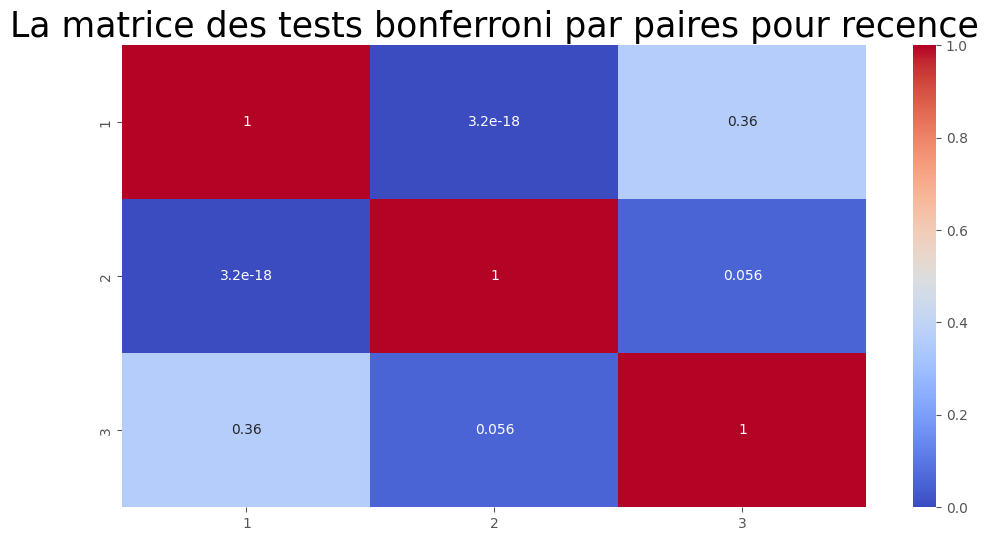

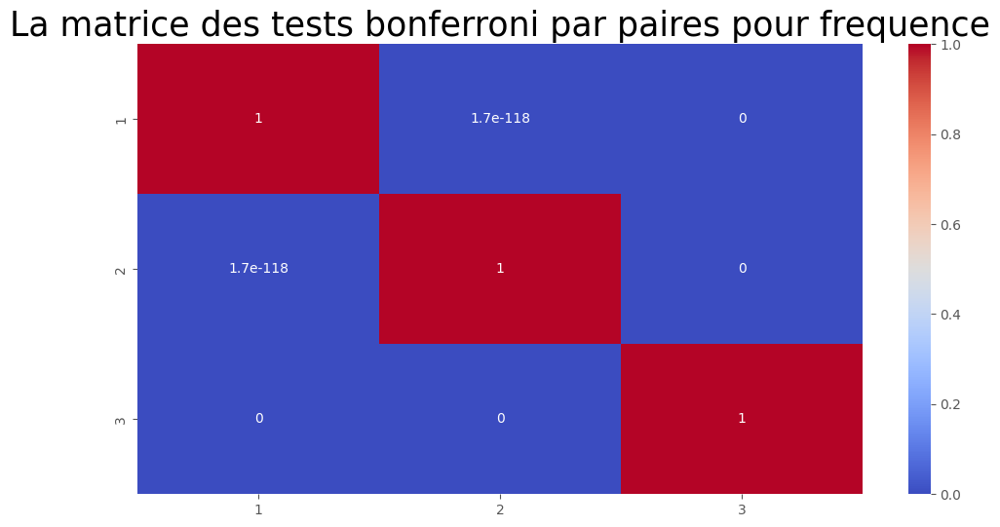

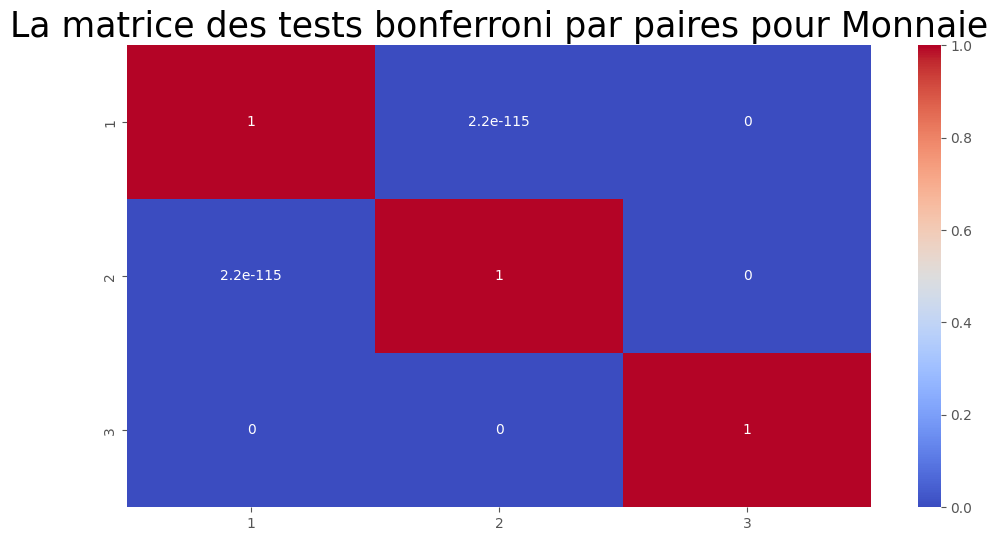

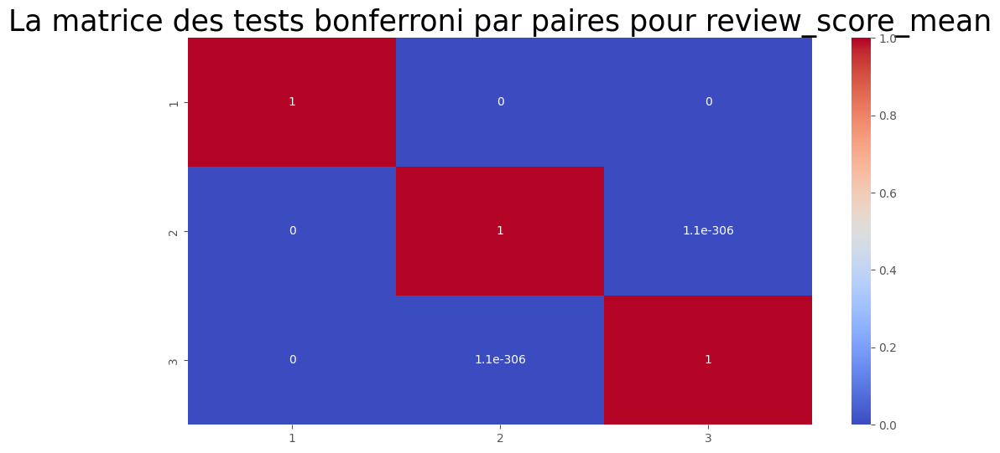

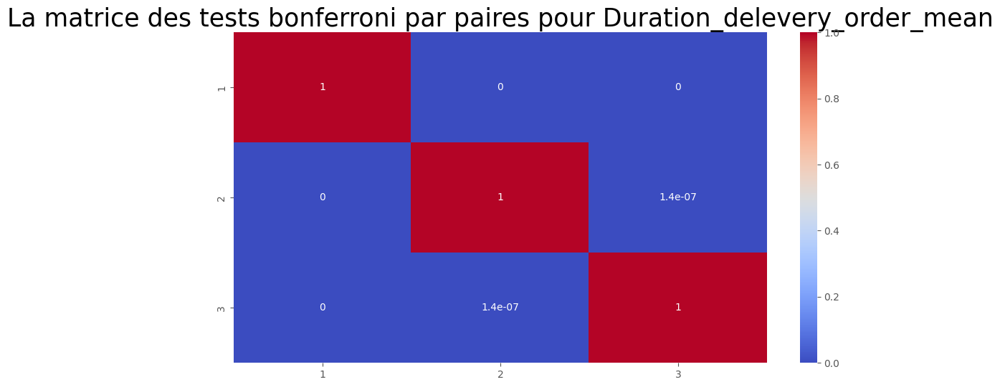

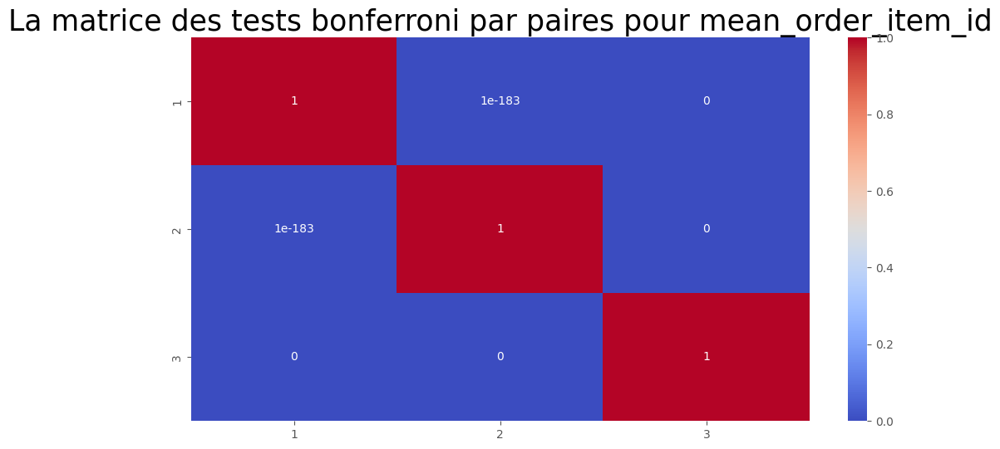

In [ ]:
#Test bonferroni comparaisons multiples par paires pour les groupes nutriscore grade

for i in list_ind:
  
  #Sélection nutriscore_score et les groupe nutriscore
  df_kruskall = DF2_kmeans[[i, 'cluster']]
  df_kruskall.head()
  #Les valeurs uniques de colonne groupe nutriscore
  grps = pd.unique(df_kruskall['cluster'].values)
  grps
  
  # création dictionnaire entre groupe nutriscore et nutriscore_score 
  d_data = {grp:df_kruskall[i][df_kruskall['cluster'] == grp].values for grp in grps}
  d_data
  
  from scipy import stats
  

  import scikit_posthocs as sp
  
  data = [d_data[0], d_data[1], d_data[2]]
  bonferroni= sp.posthoc_dunn(data, p_adjust = 'bonferroni')
  print(bonferroni)
  
  # Visualisation de la matrice Test bonferroni comparaisons multiples par paires pour les groupes nutriscore_grade
  plt.figure(figsize=(12,6))
  sns.heatmap(bonferroni, annot=True, cmap='coolwarm')
  plt.title(f'La matrice des tests bonferroni par paires pour {i}', size=25)
  print(colored('Les groupes nutriscore grade sont significativement différent 2 à 2', 'blue'))
  print('')

### ACP visualisation 

- [X] PCA 

PC1 = 0.36129161
PC2 =  0.22288263
PC3 =  0.16604472 
PC4 = 0.10984229 
PC5 = 0.09246442

In [ ]:
# supprimer Country Name et mettre les clusters en set_index afin de pouvoir visualiser les clusters 
DF_ACP_KMEANS = DF2_kmeans.drop('customer_unique_id',axis=1).set_index('cluster')
DF_ACP_KMEANS

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean
cluster,,,,,,
1,470.0,1.0,1.0,146.87,4.0,9.0
1,229.0,1.0,1.0,335.48,5.0,17.0
1,102.0,1.0,1.0,157.73,5.0,26.0
1,169.0,1.0,1.0,173.30,5.0,15.0
1,31.0,1.0,1.0,252.25,5.0,11.0
...,...,...,...,...,...,...
1,144.0,1.0,1.0,88.78,4.0,6.0
1,147.0,1.0,1.0,129.06,5.0,7.0
0,143.0,1.0,1.0,56.04,1.0,31.0


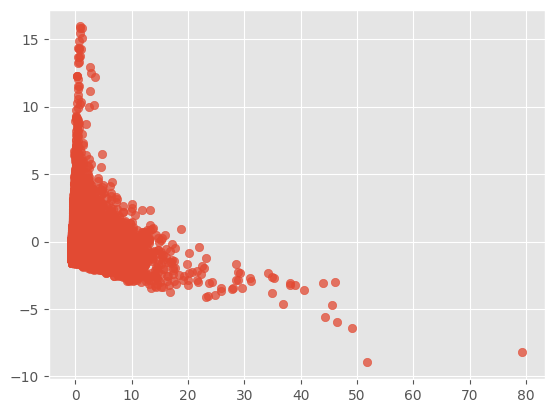

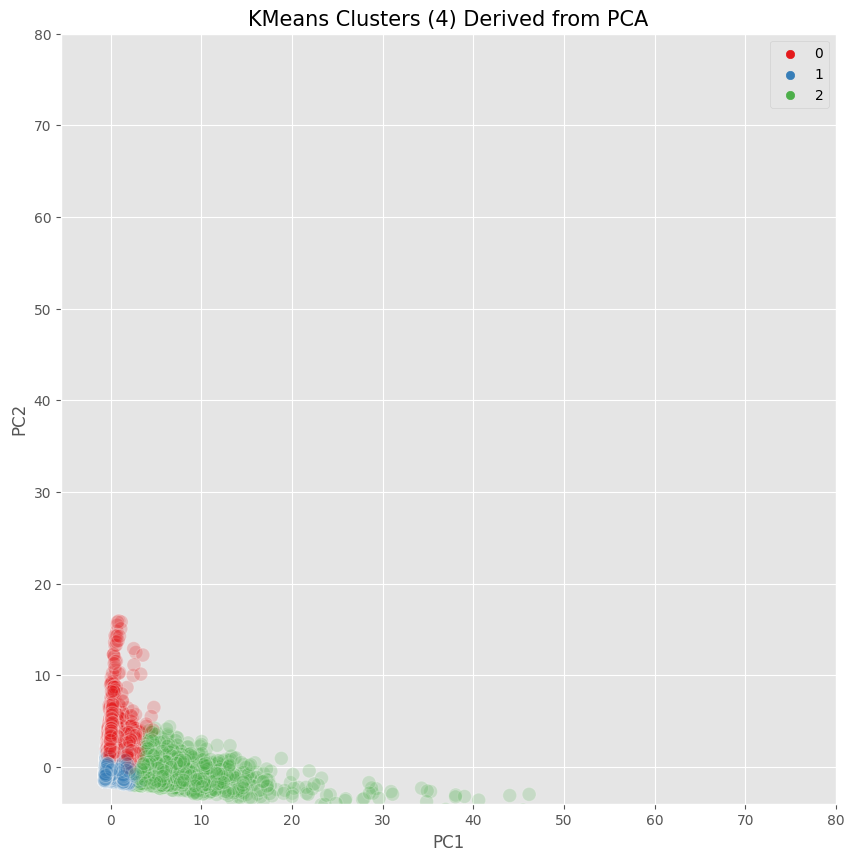

In [ ]:
# Visualiser PC1 et PC2 (plot 2D) et color les labels preds
plt.style.use('ggplot')
pca2 = PCA(n_components=0.95).fit(X_scaled)
pca2d = pca2.transform(X_scaled)


plt.figure(figsize = (10,10))
sns.scatterplot(pca2d[:,0], pca2d[:,1], 
                hue=clusters_kmeans_true, 
                palette='Set1',
                s=100, alpha=0.2).set_title('KMeans Clusters (4) Derived from PCA', fontsize=15)
plt.legend()
plt.xlim([-5.5, 80])
plt.ylim([-4, 80])
plt.ylabel('PC2')
plt.xlabel('PC1')
plt.show()

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn import decomposition
from sklearn import preprocessing
# selection des colonnes à prendre en compte dans l'ACP
data_pca = DF_ACP_KMEANS[['recence', 'frequence', 'mean_order_item_id', 'Monnaie','review_score_mean','Duration_delevery_order_mean']]
X = data_pca.values
names = DF_ACP_KMEANS.index
features = DF_ACP_KMEANS.columns

# Centrage et Réduction
std_scale = preprocessing.StandardScaler().fit(DF_ACP_KMEANS)
X_scaled = std_scale.transform(DF_ACP_KMEANS)

# Calcul des composantes principales
pca = decomposition.PCA(n_components=0.95)
df_composantes= pca.fit_transform(X_scaled)

In [ ]:
# Création df avec les composantes et les labels pred 
scores_df = pd.DataFrame(df_composantes, columns=['PC1', 'PC2', 'PC3','PC4','PC5'])
scores_df_1 = pd.concat([scores_df, DF2_kmeans['cluster']], axis=1)
scores_df_1

,PC1,PC2,PC3,PC4,PC5,cluster
0,-0.363798,0.208860,1.411962,-0.558950,-0.370110,1
1,-0.275669,-0.066545,0.101956,0.882427,-0.085937,1
2,-0.427881,0.446014,-0.722223,1.513392,0.492963,1
3,-0.455547,-0.287927,-0.268703,0.703849,0.120164,1
4,-0.406352,-0.799831,-1.122034,0.639367,-0.020909,1
...,...,...,...,...,...,...
92740,-0.467399,-0.487707,-0.623904,-0.439476,-0.178964,1
92741,-0.538938,-0.919140,-0.382623,0.156085,-0.031011,1
92742,-0.035400,2.922114,-1.381968,-0.277466,0.040840,0
92743,0.095256,-0.306047,0.553938,0.787467,-0.766100,1


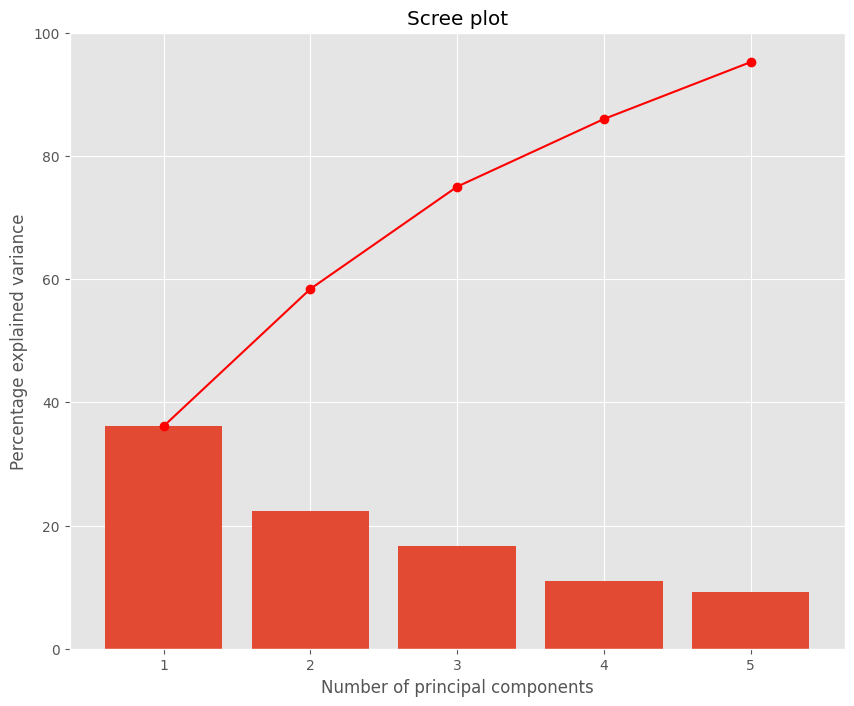

In [ ]:
# Eboulis des valeurs propres
plt.figure(figsize=(10,8))
display_scree_plot(pca)

In [ ]:
import plotly.express as px
# Plot 3D les 3 composantes et color les labels pred 
fig = px.scatter_3d(scores_df_1, x='PC1', y='PC2', z='PC3',
              color='cluster')

fig.show()

<Figure size 1500x1200 with 0 Axes>

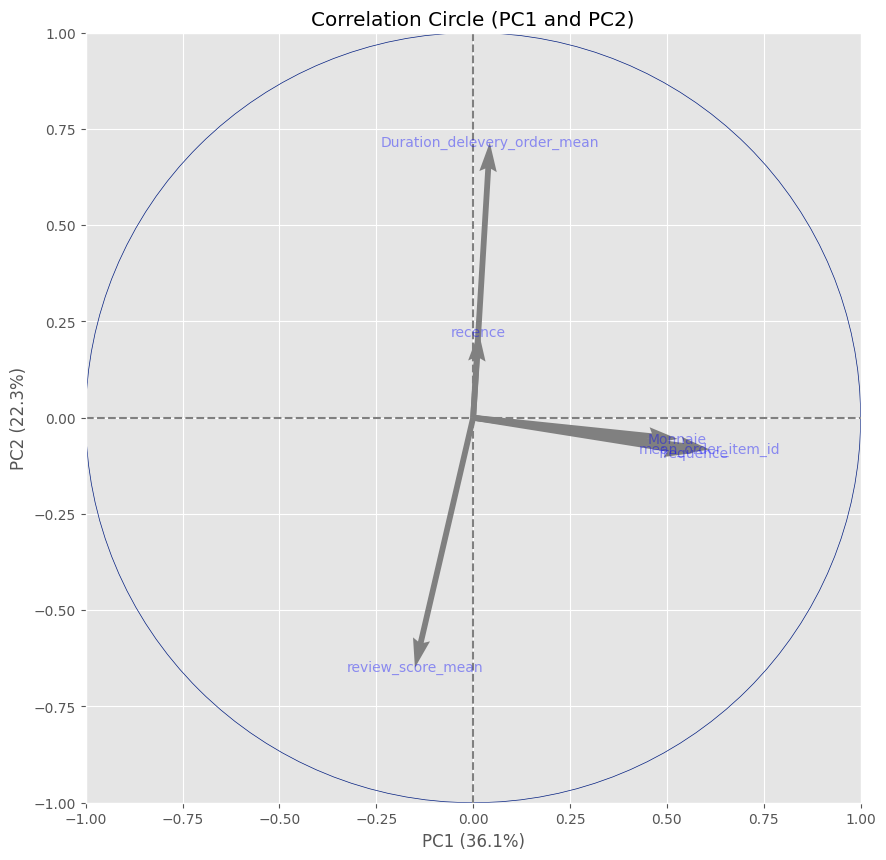

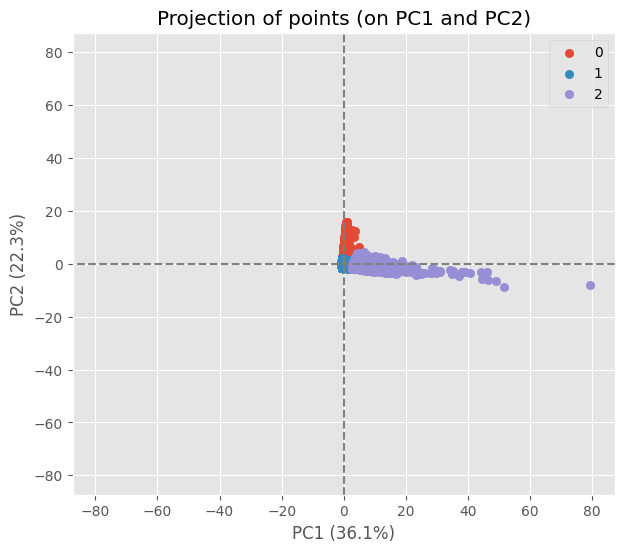

In [ ]:
# Cercle des corrélations
plt.figure(figsize=(15,12))
pcs = pca.components_
display_circles(pcs,3, pca, [(0,1),(2,3),(4,5)], labels = np.array(features))

display_factorial_planes(df_composantes, 2, pca, [(0,1)], illustrative_var = names, alpha = 1)
plt.show()

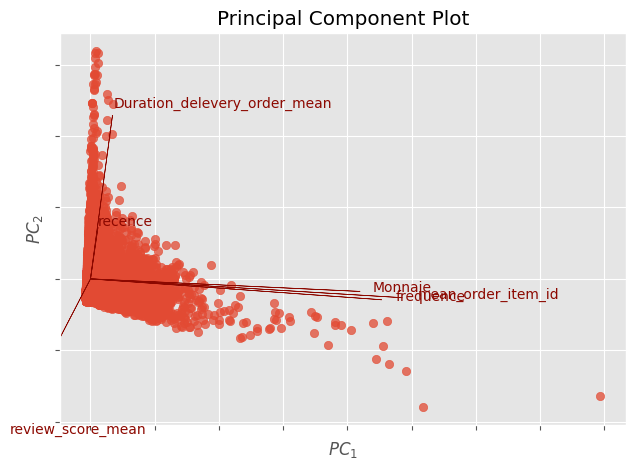

In [ ]:

from yellowbrick.features import PCA

#Biplot ACP visualisation
visualizer = PCA(scale=True, proj_features=True, classes=DF_ACP_KMEANS.reset_index()['cluster'])
visualizer.fit_transform(DF_ACP_KMEANS)
visualizer.show()


## Stabilité des clusters dans le temps

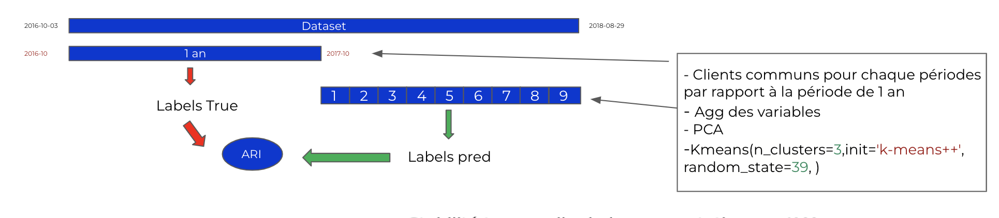


- [X] La fréquence nécessaire de mise à jour du modèle de segmentation.

> Stabilité fortement dépendante des variables choisis


> La fréquence à laquelle la segmentation doit être mise à jour est 5 mois pour qu’elle reste pertinente 


In [91]:
# supprimer outlier qui peut sensibiliser kmeans 
df_final_1 = pd.read_csv('df_final_no_agg.csv')
df_temporelle = df_final_1[~df_final_1['customer_unique_id'].isin([6186])]
df_temporelle

,Unnamed: 0,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,weekday_order_purchase,month_order_purchase,hour_order_purchase,review_score_satisfaction,recence,Duration_delevery_order
0,0,06b8999e2fba1a1fbc88172c00ba8bc7,1,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 00:00:00,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25,2017-06-05 00:00:00,1.0,credit_card,2.0,146.87,88b8b52d46df026a9d1ad2136a59b30b,4,NaN,no_review_comment_message,2017-05-26 00:00:00,2017-05-30 22:34:40,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,-20.509898,-47.397866,franca,SP,Tuesday,May,15,satisfied,470,9
1,1,18955e83d337fd6b2def6b18a428ac77,2,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 00:00:00,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29,2018-02-06 00:00:00,1.0,credit_card,8.0,335.48,02fc48a9efa3e3d0f1a8ea26507eeec3,5,NaN,no_review_comment_message,2018-01-30 00:00:00,2018-02-10 22:43:29,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,housewares,-23.726853,-46.545746,sao bernardo do campo,SP,Friday,January,20,very satisfied,229,17
2,2,4e7b3e00288586ebd08712fdd0374a03,3,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 00:00:00,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14,2018-06-13 00:00:00,1.0,credit_card,7.0,157.73,5ad6695d76ee186dc473c42706984d87,5,NaN,no_review_comment_message,2018-06-15 00:00:00,2018-06-15 12:10:59,1,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,office_furniture,-23.527788,-46.660310,sao paulo,SP,Saturday,May,16,very satisfied,102,26
3,3,b2b6027bc5c5109e529d4dc6358b12c3,4,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 00:00:00,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28,2018-04-10 00:00:00,1.0,credit_card,1.0,173.30,059a801bb31f6aab2266e672cab87bc5,5,NaN,no_review_comment_message,2018-03-29 00:00:00,2018-04-02 18:36:47,1,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,office_furniture,-23.496930,-46.185352,mogi das cruzes,SP,Tuesday,March,16,very satisfied,169,15
4,4,4f2d8ab171c80ec8364f7c12e35b23ad,5,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 00:00:00,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09,2018-08-15 00:00:00,1.0,credit_card,8.0,252.25,8490879d58d6c5d7773f2739a03f089a,5,a melhor nota,o baratheon è esxelente amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,home_confort,-22.987222,-47.151073,campinas,SP,Sunday,July,9,very satisfied,31,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114846,114857,17ddf5dd5d51696

In [92]:
# voir la première date des commandes du dataset 
df_temporelle['order_purchase_timestamp'].min()

'2016-10-03 00:00:00'

In [93]:
# voir la dernière date des commandes du dataset 
df_temporelle['order_purchase_timestamp'].max()

'2018-08-29 00:00:00'

In [94]:
# Vérifier les clients uniques 
df_temporelle['customer_unique_id'].nunique()

92745

In [95]:
# Supprimer les minutes sur order_purchase_timestamp 
#transormer colonne order_purchase_timestamp en datetime64
df_temporelle['order_purchase_month_year'] = df_temporelle['order_purchase_timestamp'].map(lambda x: str(x)[:-12])
df_temporelle['order_purchase_month_year'] = df_temporelle['order_purchase_month_year'].astype('datetime64[ns]')

In [96]:
#Split 2016-10 à 2017-10 (1 an) 
contrat_maintenance = df_temporelle[df_temporelle['order_purchase_month_year']<= np.datetime64('2016-10')+np.timedelta64(12,'M')]
contrat_maintenance

,Unnamed: 0,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,weekday_order_purchase,month_order_purchase,hour_order_purchase,review_score_satisfaction,recence,Duration_delevery_order,order_purchase_month_year
0,0,06b8999e2fba1a1fbc88172c00ba8bc7,1,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 00:00:00,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25,2017-06-05 00:00:00,1.0,credit_card,2.0,146.87,88b8b52d46df026a9d1ad2136a59b30b,4,NaN,no_review_comment_message,2017-05-26 00:00:00,2017-05-30 22:34:40,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,-20.509898,-47.397866,franca,SP,Tuesday,May,15,satisfied,470,9,2017-05-01
5,5,879864dab9bc3047522c92c82e1212b8,6,89254,jaragua do sul,SC,5741ea1f91b5fbab2bd2dc653a5b5099,delivered,2017-09-14 00:00:00,2017-09-14 18:25:11,2017-09-18 21:27:40,2017-09-28,2017-10-04 00:00:00,1.0,debit_card,1.0,282.21,9a6614162d285301aa3ef6de4be75265,5,NaN,loja responsável,2017-09-29 00:00:00,2017-10-01 21:52:53,1,0be701e03657109a8a4d5168122777fb,8f2ce03f928b567e3d56181ae20ae952,2017-09-20 18:25:11,259.90,22.31,esporte_lazer,32.0,282.0,2.0,4450.0,60.0,15.0,15.0,sports_leisure,-26.468503,-49.109883,jaragua do sul,SC,Thursday,September,18,very satisfied,349,14,2017-09-01
12,12,b2d1536598b73a9abd18e0d75d92f0a3,13,18682,lencois paulista,SP,83d8f70418eefd96f37b483dff430305,delivered,2017-09-09 00:00:00,2017-09-09 10:10:17,2017-09-12 12:42:43,2017-09-20,2017-10-02 00:00:00,1.0,credit_card,1.0,117.31,ba6eba3dfa6aca19793c270c2a349ea0,4,NaN,no_review_comment_message,2017-09-21 00:00:00,2017-09-22 01:36:59,1,3fc00af0f0a8d4ac2933d3900416c977,7a241947449cc45dbfda4f9d0798d9d0,2017-09-14 10:10:17,99.00,18.31,climatizacao,59.0,624.0,5.0,2000.0,20.0,10.0,20.0,air_conditioning,-22.604051,-48.795056,lençóis paulista,SP,Saturday,September,9,satisfied,354,11,2017-09-01
19,19,154c4ded6991bdfa3cd249d11abf4130,21,88034,florianopolis,SC,830d8b3e6875ef6165ffc33219ab4fea,delivered,2017-08-13 00:00:00,2017-08-13 10:24:04,2017-08-14 18:43:45,2017-08-19,2017-09-20 00:00:00,1.0,credit_card,1.0,123.00,dacd8ac1f6f396c009cf383f053ca550,5,NaN,no_review_comment_message,2017-08-20 00:00:00,2017-08-20 19:39:47,1,130482add9fd75ccb6c57ba007694a2d,87142160b41353c4e5fca2360caf6f92,2017-08-18 10:24:04,105.00,18.00,informatica_acessorios,55.0,60.0,1.0,2800.0,40.0,15.0,40.0,computers_accessories,-27.578659,-48.507096,florianopolis,SC,Sunday,August,10,very satisfied,381,6,2017-08-01
20,20,690172ab319622688d3b4df42f676898,22,74914,aparecida de goiania,GO,aaff8afa47c8426e414a6d908a97713c,delivered,2017-10-15 00:00:00,2017-10-15 11:25:49,2017-10-16 21:36:29,2017-10-25,2017-11-06 00:00:00,1.0,credit_card,2.0,232.71,7ed1089c451484fd5e7ee0a4036af90d,1,NaN,bom dia eu fiz uma compra de 03 peças só mim e...,2017-10-26 00:00:00,2017-10-27 09:19:26,1,368c6c730842d78016ad823897a372db,1f50f920176fa81dab994f9023523100,2017-10-19 11:25:49,59.90,17.67,ferramentas_jardim,57.0,366.0,2.0,1650.0,30.0,22.0,30.0,garden_tools,-16.754277,-49.271002,aparecida de goiania,GO,Sunday,October,11,very unsatisfied,318,10,2017-10-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [97]:
#vérifier date min et max du contrat maintenance
print(contrat_maintenance['order_purchase_month_year'].min())
print(contrat_maintenance['order_purchase_month_year'].max())

2016-10-01 00:00:00
2017-10-01 00:00:00


In [98]:
#effectuer preprocessing et prédire les labels sur la période 1 an 
train_one_year = preprocess_kmeans_maintenance(contrat_maintenance)
train_one_year

,customer_unique_id,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
0,1,470.0,1.0,1.0,146.87,4.0,9.0,0
1,6,333.5,2.0,1.0,565.88,5.0,12.0,0
2,13,354.0,1.0,1.0,117.31,4.0,11.0,0
3,21,381.0,1.0,1.0,123.00,5.0,6.0,0
4,22,318.0,3.0,2.0,698.13,1.0,10.0,2
...,...,...,...,...,...,...,...,...
29770,96079,313.0,1.0,1.0,32.77,5.0,4.0,0
29771,96080,471.0,1.0,1.0,102.03,1.0,7.0,1
29772,96084,520.0,1.0,1.0,130.85,4.0,8.0,0
29773,96086,462.0,1.0,1.0,102.03,5.0,9.0,0


In [99]:
#liste des clients de la période 1 an
customers_train_unique = list(train_one_year['customer_unique_id'].unique())

ari = {}
#boucle for afin d’effectuer le preprocessing et récupérer les mêmes clients pour chaque périodes
#comparer labels True(1 an) et les labels preds(pour les 9 mois)
for k in range(0,10):
   evolution = preprocess_kmeans_maintenance(df_temporelle[(df_temporelle['customer_unique_id'].isin(customers_train_unique))&(df_temporelle['order_purchase_month_year']<= np.datetime64('2017-10')+ np.timedelta64(k,'M'))])
   ari[k] = adjusted_rand_score(train_one_year['cluster'].values, evolution['cluster'].values)

In [100]:
#création df avec les périodes et les scores ARI
df_score_ARI = pd.DataFrame(list(ari.items()), columns=['periode', 'ARI'])
df_score_ARI

,periode,ARI
0,0,1.000000
1,1,0.996899
2,2,0.995078
3,3,0.994286
4,4,0.992258
5,5,0.989166
6,6,0.986405
7,7,0.987079
8,8,0.986183
9,9,0.984864


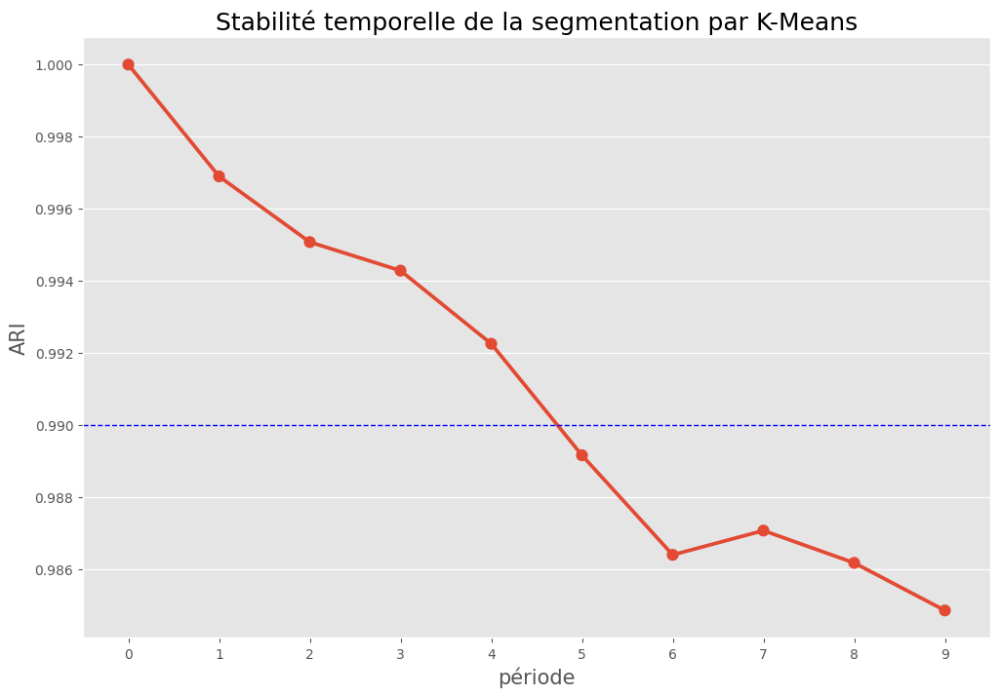

In [107]:
#plot ARI Score en fonction des périodes 
#définir seuil ou la segmentation n'est plus pertinente dans le temps
plt.figure(figsize=(12,8))
plt.title('Stabilité temporelle de la segmentation par K-Means', size=18)
sns.pointplot(x=list(ari.keys()), y=list(ari.values()))
plt.xlabel('période', size=15)
plt.ylabel('ARI', size=15)
plt.axhline(y=0.99, linestyle="--", 
            color="blue",
            linewidth=1)


# Algorithme Birch

Il s'agit d'un algorithme d'apprentissage en ligne économe en mémoire fourni comme alternative à MiniBatchKMeans. Il construit une structure de données arborescente avec les centroïdes de cluster lus sur la feuille. Ceux-ci peuvent être soit les centroïdes de cluster finaux, soit être fournis en entrée à un autre algorithme de clustering tel que AgglomerativeClustering.



- [X] PCA


- [X] Birch(branching_factor = 50, n_clusters = 4, threshold = 1.5)


- [X] Effectifs des clusters (pas homogènes, pas pertinente pour besoin métier)

> cluster 0 : 24

> cluster 1 : 24

> cluster 2 : 92589

> cluster 3 : 108

- [X] Évaluation segmentation 

> Silhouette Score: 0.8386220092169836

> calinski_harabasz Score: 6164.798339875416

> davies_bouldin Score: 0.6895434904528265

> La segmentation n'est pas pertinente car elle ne permet pas d'avoir des segments pertinents pour le besoin métier 



In [ ]:
from sklearn.cluster import Birch

#compression des données X_scaled
pca2 = PCA(n_components=0.95).fit(X_scaled)
pca2d = pca2.transform(X_scaled)
pca2d.shape

#le modèle Birch
Birch = Birch(branching_factor = 50, n_clusters = 4, threshold = 1.5)
Birch.fit(pca2d)

#Les prédictions 
clusters_Birch = Birch.labels_
clusters_Birch

array([2, 2, 2, ..., 2, 2, 2])

In [ ]:
# Add labels clusters
X_scaled_clustered_Birch = pd.DataFrame(X_scaled, columns=df_segmentation.columns, index=
                                         df_segmentation.index)
X_scaled_clustered_Birch['cluster'] = clusters_Birch
X_scaled_clustered_Birch

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
customer_unique_id,,,,,,,
1,1.518537,-0.281762,-0.265945,-0.123550,-0.119799,-0.365816,2
2,-0.063335,-0.281762,-0.265945,0.240407,0.661153,0.478991,2
3,-0.896936,-0.281762,-0.265945,-0.102594,0.661153,1.429399,2
4,-0.457162,-0.281762,-0.265945,-0.072549,0.661153,0.267789,2
5,-1.362964,-0.281762,-0.265945,0.079799,0.661153,-0.154614,2
...,...,...,...,...,...,...,...
96092,-0.621257,-0.281762,-0.265945,-0.235646,-0.119799,-0.682618,2
96093,-0.601565,-0.281762,-0.265945,-0.157918,0.661153,-0.577017,2
96094,-0.627820,-0.281762,-0.265945,-0.298823,-2.462655,1.957403,2


In [ ]:
#Création dataframe pour les clusters 
segmen_clusters_Birch = pd.DataFrame(clusters_Birch)
DF_Birch = df_segmentation.reset_index()
DF1_Birch= pd.concat([DF_Birch, segmen_clusters_Birch], axis=1)
DF2_Birch = DF1_Birch.rename(columns={0:'cluster'})
DF2_Birch

,customer_unique_id,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
0,1,470.0,1.0,1.0,146.87,4.0,9.0,2
1,2,229.0,1.0,1.0,335.48,5.0,17.0,2
2,3,102.0,1.0,1.0,157.73,5.0,26.0,2
3,4,169.0,1.0,1.0,173.30,5.0,15.0,2
4,5,31.0,1.0,1.0,252.25,5.0,11.0,2
...,...,...,...,...,...,...,...,...
92740,96092,144.0,1.0,1.0,88.78,4.0,6.0,2
92741,96093,147.0,1.0,1.0,129.06,5.0,7.0,2
92742,96094,143.0,1.0,1.0,56.04,1.0,31.0,2
92743,96095,299.0,1.0,1.0,711.07,5.0,13.0,2


In [ ]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_Birch = X_scaled_clustered_Birch.groupby('cluster').mean()
centroide_Birch

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean
cluster,,,,,,
0,-0.183726,12.332130,16.537105,38.596197,-1.388846,0.135648
1,0.090845,25.290934,8.700585,3.392096,-0.628915,-0.022437
2,0.000140,-0.017253,-0.016538,-0.024346,0.001283,-0.000320
3,-0.099652,6.430318,8.569883,11.541347,-0.651432,0.249413


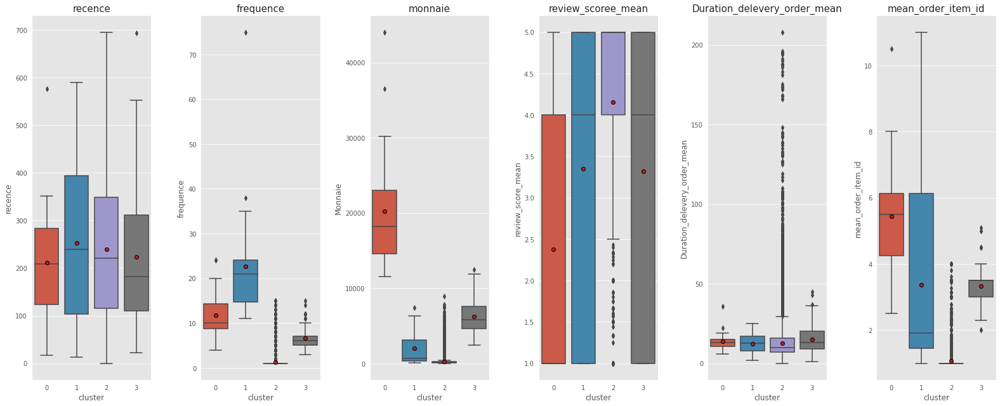

In [ ]:
# Comparer chaque clusters pour chaque dimensions
plt.style.use('ggplot')
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

_, axes = plt.subplots (1, 6 ,sharey = False, figsize = (22, 9)) 
sns.boxplot(x = 'cluster', y = 'recence', 
            data = DF2_Birch, showmeans=True,meanprops=meanprops, ax = axes [0])
axes[0].set_title("recence",size=15); 
#plt.subplots_adjust(hspace=150)

sns.boxplot(x = 'cluster', y = 'frequence', 
               data =  DF2_Birch, showmeans=True,meanprops=meanprops, ax = axes [1])
axes[1].set_title("frequence",size=15);
#plt.subplots_adjust(hspace=100)

sns.boxplot(x = 'cluster', y = 'Monnaie', 
               data = DF2_Birch ,showmeans=True,meanprops=meanprops, ax = axes [2])
axes[2].set_title("monnaie",size=15);
#plt.subplots_adjust(hspace=100)


sns.boxplot(x = 'cluster', y = 'review_score_mean', 
               data = DF2_Birch ,showmeans=True,meanprops=meanprops, ax = axes [3])
axes[3].set_title("review_scoree_mean", size=15);
#plt.subplots_adjust(hspace=100)

sns.boxplot(x = 'cluster', y = 'Duration_delevery_order_mean', 
               data = DF2_Birch ,showmeans=True,meanprops=meanprops, ax = axes [4])
axes[4].set_title("Duration_delevery_order_mean", size=15);
#plt.subplots_adjust(hspace=100)

sns.boxplot(x = 'cluster', y = 'mean_order_item_id', 
              data = DF2_Birch ,showmeans=True,meanprops=meanprops, ax = axes [5])
axes[5].set_title("mean_order_item_id", size=15);
#plt.subplots_adjust(hspace=100)

plt.tight_layout()

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

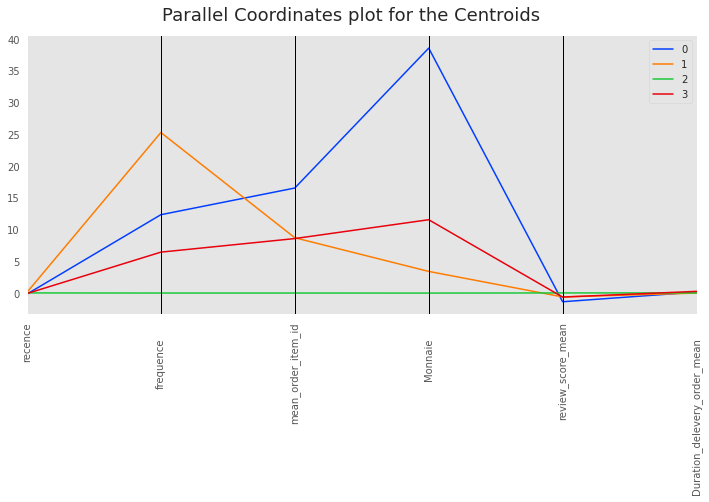

In [ ]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
display_parallel_coordinates_centroids(centroide_Birch.reset_index(), 4)
plt.xticks(rotation=90)

In [ ]:
# afficher les effectifs pour segmentation Birch
for i in range(4):
  print(colored('Les clusters pour segmentation Birch', 'blue'))
  print(f"Le nombre de clients dans le cluster {i} :", len(DF2_Birch[DF2_Birch['cluster']==i]['customer_unique_id']))
  Birch_effectif = list(DF2_Birch[DF2_Birch['cluster']==i]['customer_unique_id'])

Les clusters pour segmentation Birch
Le nombre de clients dans le cluster 0 : 24
Les clusters pour segmentation Birch
Le nombre de clients dans le cluster 1 : 24
Les clusters pour segmentation Birch
Le nombre de clients dans le cluster 2 : 92589
Les clusters pour segmentation Birch
Le nombre de clients dans le cluster 3 : 108


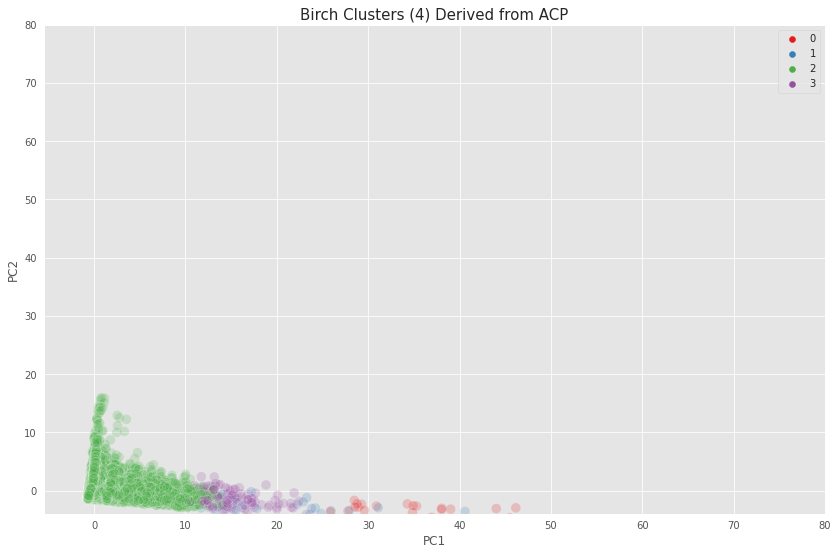

In [ ]:
# Visualiser PC1 et PC2 (plot 2D) et color les labels preds
plt.figure(figsize = (14,9))
sns.scatterplot(pca2d[:,0], pca2d[:,1], 
                hue=clusters_Birch, 
                palette='Set1',
                s=100, alpha=0.2).set_title('Birch Clusters (4) Derived from ACP', fontsize=15)
plt.legend()
plt.xlim([-5.5, 80])
plt.ylim([-4, 80])
plt.ylabel('PC2')
plt.xlabel('PC1')
plt.show()

In [ ]:
# Création df avec les composantes et les labels pred 
scores_df = pd.DataFrame(pca2d, columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5'])
scores_df_1 = pd.concat([scores_df, DF2_Birch['cluster']], axis=1)
scores_df_1

,PC1,PC2,PC3,PC4,PC5,cluster
0,-0.363798,0.208860,1.411962,-0.558950,-0.370110,2
1,-0.275669,-0.066545,0.101956,0.882427,-0.085937,2
2,-0.427881,0.446014,-0.722223,1.513392,0.492963,2
3,-0.455547,-0.287927,-0.268703,0.703849,0.120164,2
4,-0.406352,-0.799831,-1.122034,0.639367,-0.020909,2
...,...,...,...,...,...,...
92740,-0.467399,-0.487707,-0.623904,-0.439476,-0.178964,2
92741,-0.538938,-0.919140,-0.382623,0.156085,-0.031011,2
92742,-0.035400,2.922114,-1.381968,-0.277466,0.040840,2
92743,0.095256,-0.306047,0.553938,0.787467,-0.766100,2


In [ ]:
import plotly.express as px
# Plot 3D les 3 composantes et color les labels pred 
fig = px.scatter_3d(scores_df_1, x='PC1', y='PC2', z='PC3',
              color='cluster')

fig.show()

In [ ]:
from sklearn import metrics
from sklearn.metrics import davies_bouldin_score

#évalution avec les metrics Silhouette Score,calinski_harabasz Score, davies_bouldin Score

print('Birch ACP Scaled Silhouette Score: {}'.format(silhouette_score(pca2d, clusters_Birch)))
print('Birch ACP Scaled calinski_harabasz Score: {}'.format(metrics.calinski_harabasz_score(pca2d, clusters_Birch)))
print('Birch ACP Scaled davies_bouldin Score: {}'.format(davies_bouldin_score(pca2d, clusters_Birch)))

Birch ACP Scaled Silhouette Score: 0.8386220092169836
Birch ACP Scaled calinski_harabasz Score: 6164.798339875416
Birch ACP Scaled davies_bouldin Score: 0.6895434904528265


# Algorithme Hdbscan 


HDBSCAN est un algorithme de clustering développé par Campello, Moulavi et Sander . Il étend DBSCAN en le convertissant en un algorithme de clustering hiérarchique, puis en utilisant une technique pour extraire un clustering plat basé sur la stabilité des clusters. 



- [X] PCA


- [X] HDBSCAN(min_cluster_size=500,min_samples=100, gen_min_span_tree=True)


- [X] Effectifs des clusters (pas homogènes, pas pertinente pour besoin métier)



> cluster -1 (bruit): 8350

> cluster 0 : 3003

> cluster 1 : 6092

> cluster 2 : 46826

> cluster 3 : 15506

> cluster 4 : 1897

> cluster 5 : 6055

> cluster 6 : 867

> cluster 7 : 4149

- [X] Évaluation segmentation 


- Silhouette Score: 0.08762693993063451

- calinski_harabasz Score: 5985.50482855531

- davies_bouldin Score: 2.625674345728458

> La segmentation n'est pas pertinente car l'evaluation est insatisfaisant 

In [175]:
# importer hdbscan
import hdbscan

In [125]:
# Fit les données avec le modèle HDBSCAN
clusterer = hdbscan.HDBSCAN(min_cluster_size=500,min_samples=100, gen_min_span_tree=True)
clusterer.fit(pca2d)

#Les prédictions 
clusters_HDBSCAN = clusterer.labels_
clusters_HDBSCAN

array([3, 2, 2, ..., 1, 2, 2])

In [126]:
# Add labels clusters
X_scaled_clustered_HDBSCAN = pd.DataFrame(X_scaled, columns=df_segmentation.columns, index=
                                         df_segmentation.index)
X_scaled_clustered_HDBSCAN['cluster'] = clusters_HDBSCAN
X_scaled_clustered_HDBSCAN

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
customer_unique_id,,,,,,,
1,1.518537,-0.281762,-0.265945,-0.123550,-0.119799,-0.365816,3
2,-0.063335,-0.281762,-0.265945,0.240407,0.661153,0.478991,2
3,-0.896936,-0.281762,-0.265945,-0.102594,0.661153,1.429399,2
4,-0.457162,-0.281762,-0.265945,-0.072549,0.661153,0.267789,2
5,-1.362964,-0.281762,-0.265945,0.079799,0.661153,-0.154614,2
...,...,...,...,...,...,...,...
96092,-0.621257,-0.281762,-0.265945,-0.235646,-0.119799,-0.682618,3
96093,-0.601565,-0.281762,-0.265945,-0.157918,0.661153,-0.577017,2
96094,-0.627820,-0.281762,-0.265945,-0.298823,-2.462655,1.957403,1


In [127]:
#Création dataframe pour les clusters 
segmen_clusters_HDBSCAN = pd.DataFrame(clusters_HDBSCAN)
DF_HDBSCAN = df_segmentation.reset_index()
DF1_HDBSCAN= pd.concat([DF_HDBSCAN, segmen_clusters_HDBSCAN], axis=1)
DF2_HDBSCAN = DF1_HDBSCAN.rename(columns={0:'cluster'})
DF2_HDBSCAN

,customer_unique_id,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean,cluster
0,1,470.0,1.0,1.0,146.87,4.0,9.0,3
1,2,229.0,1.0,1.0,335.48,5.0,17.0,2
2,3,102.0,1.0,1.0,157.73,5.0,26.0,2
3,4,169.0,1.0,1.0,173.30,5.0,15.0,2
4,5,31.0,1.0,1.0,252.25,5.0,11.0,2
...,...,...,...,...,...,...,...,...
92740,96092,144.0,1.0,1.0,88.78,4.0,6.0,3
92741,96093,147.0,1.0,1.0,129.06,5.0,7.0,2
92742,96094,143.0,1.0,1.0,56.04,1.0,31.0,1
92743,96095,299.0,1.0,1.0,711.07,5.0,13.0,2


In [128]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
centroide_HDBSCAN = X_scaled_clustered_HDBSCAN.groupby('cluster').mean()
centroide_HDBSCAN

,recence,frequence,mean_order_item_id,Monnaie,review_score_mean,Duration_delevery_order_mean
cluster,,,,,,
-1,0.253183,1.660598,1.615741,1.287100,-0.725529,0.762341
0,0.124714,0.900790,-0.265945,-0.079646,0.321779,-0.178245
1,-0.072905,-0.281762,-0.265945,-0.156334,-2.462655,0.904757
2,-0.036388,-0.281762,-0.265945,-0.143819,0.661153,-0.215623
3,-0.001543,-0.281762,-0.265945,-0.160684,-0.119799,-0.057512
4,-0.005237,-0.281762,-0.265945,-0.180247,-1.681703,0.280983
5,0.035476,-0.281762,-0.265945,-0.176427,-0.900751,0.101165
6,-0.296079,0.904882,1.618879,0.217343,-2.457251,-0.138090
7,-0.063824,1.003683,1.498056,0.215014,0.425998,-0.332457


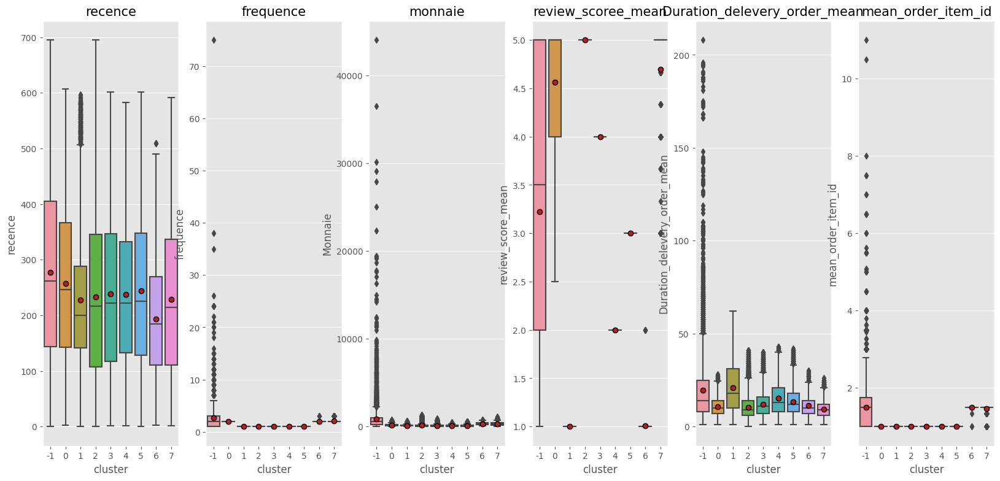

In [129]:
# Comparer chaque clusters pour chaque dimensions

meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

_, axes = plt.subplots (1, 6 ,sharey = False, figsize = (20, 9)) 
sns.boxplot(x = 'cluster', y = 'recence', 
            data = DF2_HDBSCAN, showmeans=True,meanprops=meanprops, ax = axes [0])
axes[0].set_title("recence",size=15); 

plt.subplots_adjust(hspace=50)
sns.boxplot(x = 'cluster', y = 'frequence', 
               data =  DF2_HDBSCAN, showmeans=True,meanprops=meanprops, ax = axes [1])
axes[1].set_title("frequence",size=15);
plt.subplots_adjust(hspace=50)

sns.boxplot(x = 'cluster', y = 'Monnaie', 
               data = DF2_HDBSCAN ,showmeans=True,meanprops=meanprops, ax = axes [2])
axes[2].set_title("monnaie",size=15);
plt.subplots_adjust(hspace=50)


sns.boxplot(x = 'cluster', y = 'review_score_mean', 
               data = DF2_HDBSCAN ,showmeans=True,meanprops=meanprops, ax = axes [3])
axes[3].set_title("review_scoree_mean", size=15);

sns.boxplot(x = 'cluster', y = 'Duration_delevery_order_mean', 
               data = DF2_HDBSCAN ,showmeans=True,meanprops=meanprops, ax = axes [4])
axes[4].set_title("Duration_delevery_order_mean", size=15);

sns.boxplot(x = 'cluster', y = 'mean_order_item_id', 
              data = DF2_HDBSCAN ,showmeans=True,meanprops=meanprops, ax = axes [5])
axes[5].set_title("mean_order_item_id", size=15);

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

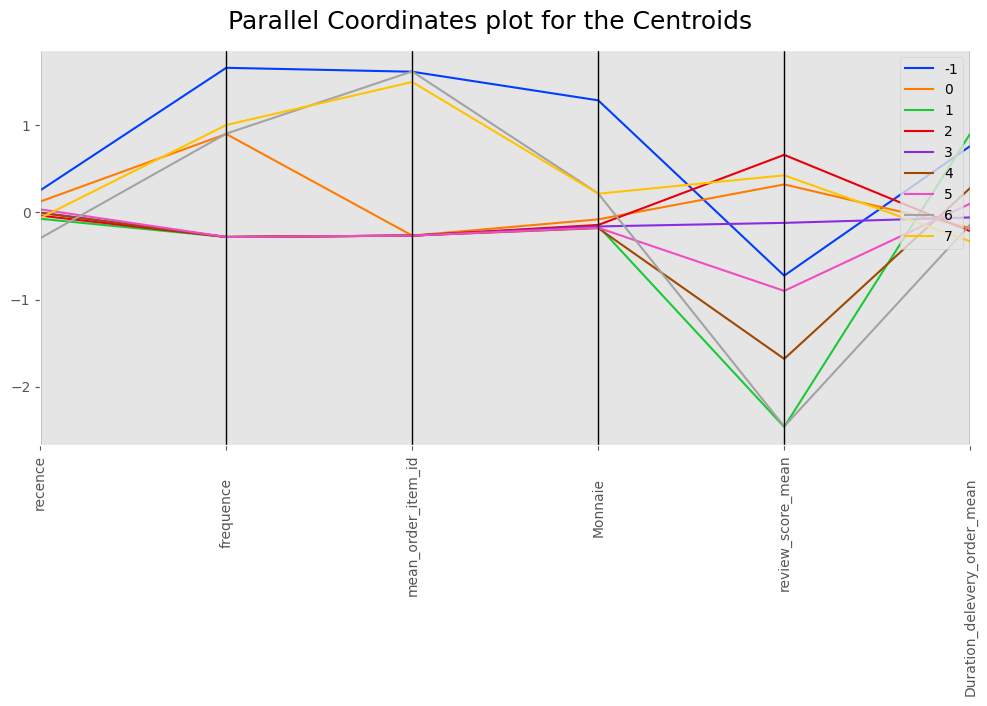

In [130]:
# les centroïdes des groupes et leurs coordonnées dans chacune des dimensions
display_parallel_coordinates_centroids(centroide_HDBSCAN.reset_index(), 4)
plt.xticks(rotation=90)

In [131]:
# afficher les effectifs de la segmentation HDBSCAN 

print(colored('Les clusters eps pour segmentation HDBSCAN', 'red'))
print(f"Le nombre de clients dans le cluster -1 :", len(DF2_HDBSCAN[DF2_HDBSCAN['cluster']==-1]['customer_unique_id']))
print('')
for i in range(8):
  print(colored('Les clusters pour segmentation HDBSCAN', 'blue'))
  print(f"Le nombre de clients dans le cluster {i} :", len(DF2_HDBSCAN[DF2_HDBSCAN['cluster']==i]['customer_unique_id']))
  HDBSCAN_effectif = list(DF2_HDBSCAN[DF2_HDBSCAN['cluster']==i]['customer_unique_id'])
  

Les clusters eps pour segmentation HDBSCAN
Le nombre de clients dans le cluster -1 : 8350

Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 0 : 3003
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 1 : 6092
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 2 : 46826
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 3 : 15506
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 4 : 1897
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 5 : 6055
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 6 : 867
Les clusters pour segmentation HDBSCAN
Le nombre de clients dans le cluster 7 : 4149


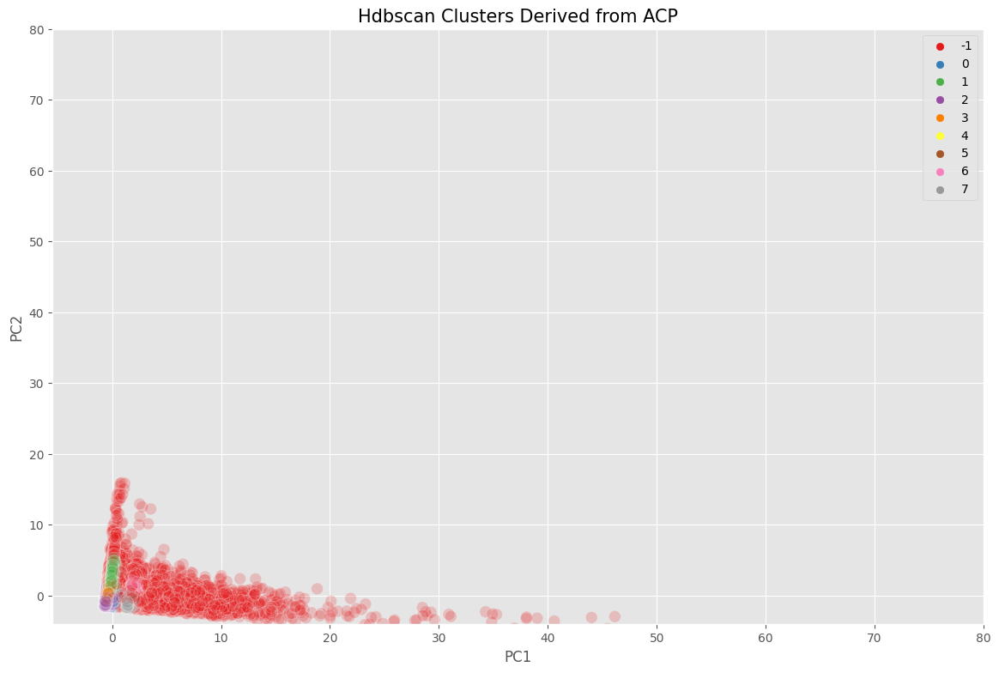

In [132]:
# Visualiser PC1 et PC2 (plot 2D) et color les labels preds

plt.figure(figsize = (14,9))
sns.scatterplot(pca2d[:,0], pca2d[:,1], 
                hue=clusters_HDBSCAN, 
                palette='Set1',
                s=100, alpha=0.2).set_title('Hdbscan Clusters Derived from ACP', fontsize=15)
plt.legend()
plt.xlim([-5.5, 80])
plt.ylim([-4, 80])
plt.ylabel('PC2')
plt.xlabel('PC1')
plt.show()

In [133]:
# Création df avec les composantes et les labels pred 
scores_df = pd.DataFrame(pca2d, columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5'])
scores_df_1 = pd.concat([scores_df, DF2_HDBSCAN['cluster']], axis=1)
scores_df_1

,PC1,PC2,PC3,PC4,PC5,cluster
0,-0.363798,0.208860,1.411962,-0.558950,-0.370110,3
1,-0.275669,-0.066545,0.101956,0.882427,-0.085937,2
2,-0.427881,0.446014,-0.722223,1.513392,0.492963,2
3,-0.455547,-0.287927,-0.268703,0.703849,0.120164,2
4,-0.406352,-0.799831,-1.122034,0.639367,-0.020909,2
...,...,...,...,...,...,...
92740,-0.467399,-0.487707,-0.623904,-0.439476,-0.178964,3
92741,-0.538938,-0.919140,-0.382623,0.156085,-0.031011,2
92742,-0.035400,2.922114,-1.381968,-0.277466,0.040840,1
92743,0.095256,-0.306047,0.553938,0.787467,-0.766100,2


In [134]:
import plotly.express as px
# Plot 3D les 3 composantes et color les labels pred 
fig = px.scatter_3d(scores_df_1, x='PC1', y='PC2', z='PC3',
              color='cluster')

fig.show()

In [ ]:
#évalution avec les metrics Silhouette Score,calinski_harabasz Score, davies_bouldin Score
print('HDBSCAN ACP Scaled Silhouette Score: {}'.format(silhouette_score(pca2d, clusters_HDBSCAN)))
print('HDBSCAN ACP Scaled calinski_harabasz Score: {}'.format(metrics.calinski_harabasz_score(pca2d, clusters_HDBSCAN)))
print('HDBSCAN ACP Scaled davies_bouldin Score: {}'.format(davies_bouldin_score(pca2d, clusters_HDBSCAN)))

HDBSCAN ACP Scaled Silhouette Score: 0.08762693993063451
HDBSCAN ACP Scaled calinski_harabasz Score: 5985.50482855531
HDBSCAN ACP Scaled davies_bouldin Score: 2.625674345728458
